In [1]:
import tensorflow as tf
import segmentation_models as sm
import glob
import cv2
import os
import numpy as np
from matplotlib import pyplot as plt
import keras 

from keras.utils import normalize
from keras.metrics import MeanIoU

print(keras.__version__)
print(tf.__version__)

#Resizing images, if needed
SIZE_X = 128 
SIZE_Y = 128
n_classes=4 #Number of classes for segmentation

#Capture training image info as a list
train_images = []

for directory_path in glob.glob("../data/patches_128_useful/patch_img/"):
    for img_path in glob.glob(os.path.join(directory_path, "*.jpg")):
        # print(img_path, sep = ' ')
        img = cv2.imread(img_path, 1)       
        # img = cv2.resize(img, (SIZE_Y, SIZE_X))
        train_images.append(img)
       
#Convert list to array for machine learning processing        
train_images = np.array(train_images)
print(train_images.shape)

#Capture mask/label info as a list
train_masks = [] 

for directory_path in glob.glob("../data/patches_128_useful/patch_mask/"):
    for mask_path in glob.glob(os.path.join(directory_path, "*.tif")):
        # print(mask_path, sep = ' ')
        mask = cv2.imread(mask_path, 0)       
        # mask = cv2.resize(mask, (SIZE_Y, SIZE_X), interpolation = cv2.INTER_NEAREST)  #Otherwise ground truth changes due to interpolation
        train_masks.append(mask)
        
#Convert list to array for machine learning processing          
train_masks = np.array(train_masks)
print(train_masks.shape)

#Encode labels... but multi dim array so need to flatten, encode and reshape
from sklearn.preprocessing import LabelEncoder
labelencoder = LabelEncoder()
n, h, w = train_masks.shape
train_masks_reshaped = train_masks.reshape(-1,1)
train_masks_reshaped_encoded = labelencoder.fit_transform(train_masks_reshaped)
train_masks_encoded_original_shape = train_masks_reshaped_encoded.reshape(n, h, w)

np.unique(train_masks_encoded_original_shape)

#train_images = np.expand_dims(train_images, axis=3)
#train_images = normalize(train_images, axis=1)

train_masks_input = np.expand_dims(train_masks_encoded_original_shape, axis=3)

#Create a subset of data for quick testing
#Picking 10% for testing and remaining for training
from sklearn.model_selection import train_test_split
X1, X_test, y1, y_test = train_test_split(train_images, train_masks_input, test_size = 0.10, random_state = 0)
# #Further split training data t a smaller subset for quick testing of models
X_train, X_do_not_use, y_train, y_do_not_use = train_test_split(X1, y1, test_size = 0.3, random_state = 0)


#Full Data
# X_train, X_test, y_train, y_test = train_test_split(train_images, train_masks_input, test_size = 0.10, random_state = 0)
print("Class values in the dataset are ... ", np.unique(y_train))  # 0 is the background/few unlabeled 

from keras.utils import to_categorical
train_masks_cat = to_categorical(y_train, num_classes=n_classes)
y_train_cat = train_masks_cat.reshape((y_train.shape[0], y_train.shape[1], y_train.shape[2], n_classes))


test_masks_cat = to_categorical(y_test, num_classes=n_classes)
y_test_cat = test_masks_cat.reshape((y_test.shape[0], y_test.shape[1], y_test.shape[2], n_classes))

# Add print statements to check tensor shapes
print("Input shapes:")
print("X_train shape:", X_train.shape)
print("y_train_cat shape:", y_train_cat.shape)
print("X_test shape:", X_test.shape)
print("y_test_cat shape:", y_test_cat.shape)


###Model 3
BACKBONE3 = 'vgg19'
preprocess_input3 = sm.get_preprocessing(BACKBONE3)

# preprocess input
X_train3 = preprocess_input3(X_train)
X_test3 = preprocess_input3(X_test)

Segmentation Models: using `keras` framework.
2.13.1
2.14.0
../data/patches_128_useful/patch_img\image_100_1_1.jpg
../data/patches_128_useful/patch_img\image_100_1_2.jpg
../data/patches_128_useful/patch_img\image_100_1_3.jpg
../data/patches_128_useful/patch_img\image_100_1_4.jpg
../data/patches_128_useful/patch_img\image_100_2_1.jpg
../data/patches_128_useful/patch_img\image_100_2_2.jpg
../data/patches_128_useful/patch_img\image_100_2_3.jpg
../data/patches_128_useful/patch_img\image_100_2_4.jpg
../data/patches_128_useful/patch_img\image_100_3_1.jpg
../data/patches_128_useful/patch_img\image_100_3_2.jpg
../data/patches_128_useful/patch_img\image_100_3_3.jpg
../data/patches_128_useful/patch_img\image_100_3_4.jpg
../data/patches_128_useful/patch_img\image_100_3_5.jpg
../data/patches_128_useful/patch_img\image_100_4_1.jpg
../data/patches_128_useful/patch_img\image_100_4_2.jpg
../data/patches_128_useful/patch_img\image_100_4_3.jpg
../data/patches_128_useful/patch_img\image_100_4_4.jpg
../da

C:\Users\sagni\AppData\Roaming\Python\Python39\site-packages\sklearn\preprocessing\_label.py:114: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Class values in the dataset are ...  [0 1 2 3]
Input shapes:
X_train shape: (2249, 128, 128, 3)
y_train_cat shape: (2249, 128, 128, 4)
X_test shape: (358, 128, 128, 3)
y_test_cat shape: (358, 128, 128, 4)


In [2]:
from keras.models import load_model
### FOR NOW LET US FOCUS ON A SINGLE MODEL

#Set compile=False as we are not loading it for training, only for prediction.
# model1 = load_model('../SavedModels/res34_backbone_200epochs.hdf5', compile=False)
model3 = load_model('../Segmentation_Models/vgg19/CheckPoints/weights-improvement_vgg19.hdf5', compile=False)

# plot graph
#IOU
y_pred3=model3.predict(X_test3)
y_pred3_argmax=np.argmax(y_pred3, axis=3)


#Using built in keras function
#from keras.metrics import MeanIoU
n_classes = 4
IOU_keras = MeanIoU(num_classes=n_classes)  
IOU_keras.update_state(y_test[:,:,:,0], y_pred3_argmax)
print("Mean IoU =", IOU_keras.result().numpy())

12/12 [==============================] - 19s 2s/step
Mean IoU = 0.85031855


In [3]:
#To calculate I0U for each class...
values = np.array(IOU_keras.get_weights()).reshape(n_classes, n_classes)
print(values)
class1_IoU = values[0,0]/(values[0,0] + values[0,1] + values[0,2] + values[0,3] + values[1,0]+ values[2,0]+ values[3,0])
class2_IoU = values[1,1]/(values[1,1] + values[1,0] + values[1,2] + values[1,3] + values[0,1]+ values[2,1]+ values[3,1])
class3_IoU = values[2,2]/(values[2,2] + values[2,0] + values[2,1] + values[2,3] + values[0,2]+ values[1,2]+ values[3,2])
class4_IoU = values[3,3]/(values[3,3] + values[3,0] + values[3,1] + values[3,2] + values[0,3]+ values[1,3]+ values[2,3])

print("IoU for class1 is: ", class1_IoU)
print("IoU for class2 is: ", class2_IoU)
print("IoU for class3 is: ", class3_IoU)
print("IoU for class4 is: ", class4_IoU)

#Verify the prediction on first image

[[3.730333e+06 5.765000e+04 6.036400e+04 5.170000e+03]
 [4.014500e+04 6.582360e+05 4.106700e+04 2.906000e+03]
 [2.288700e+04 2.879400e+04 1.119584e+06 8.190000e+02]
 [8.079000e+03 4.354000e+03 1.782000e+03 8.330200e+04]]
IoU for class1 is:  0.9504934
IoU for class2 is:  0.7900551
IoU for class3 is:  0.8779006
IoU for class4 is:  0.78282523


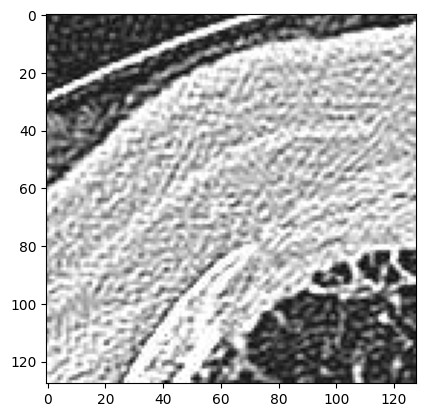

In [4]:
plt.imshow(train_images[0, :,:,0], cmap='gray')

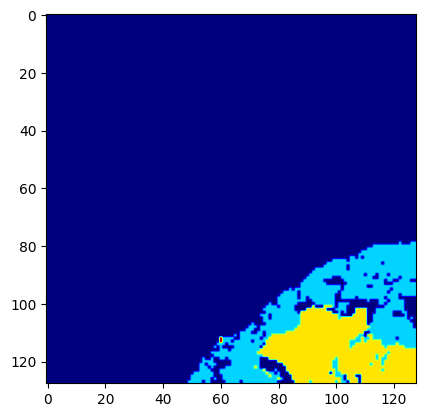

In [5]:
plt.imshow(train_masks[0], cmap='jet')

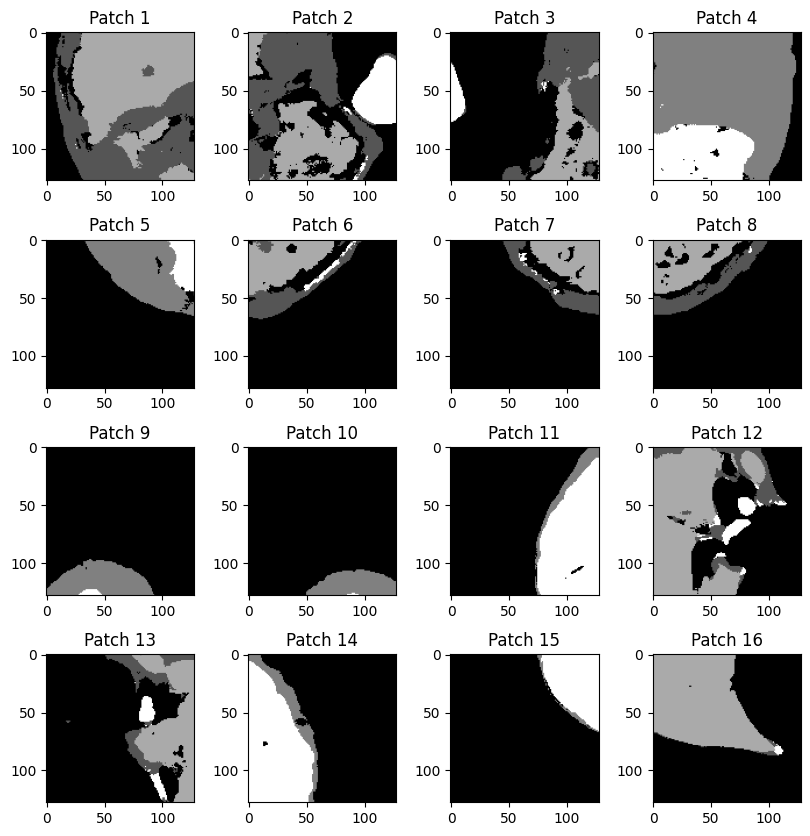

In [6]:
import matplotlib.pyplot as plt

# Create a figure with a larger size
fig = plt.figure(figsize=(10, 10))

# Assuming train_masks contains at least 16 mask images
for i in range(16):
    ax = fig.add_subplot(4, 4, i + 1)  # Create a 4x4 grid of subplots
    ax.imshow(train_masks[i+48], cmap='gray') #16 patches make a single image
    ax.set_title(f"Patch {i + 1}")  # Add a title for each subplot

# Adjust spacing between subplots
plt.subplots_adjust(wspace=0.2, hspace=0.4)
plt.show()  # Display all 16 images

1/1 [==============================] - 0s 84ms/step


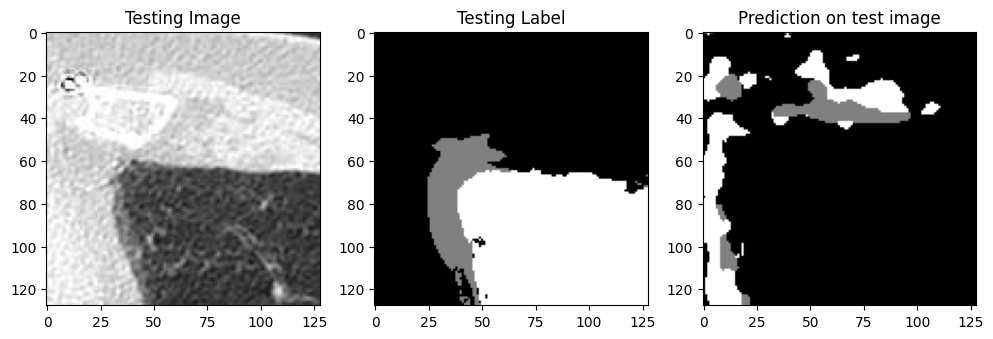

1/1 [==============================] - 0s 88ms/step


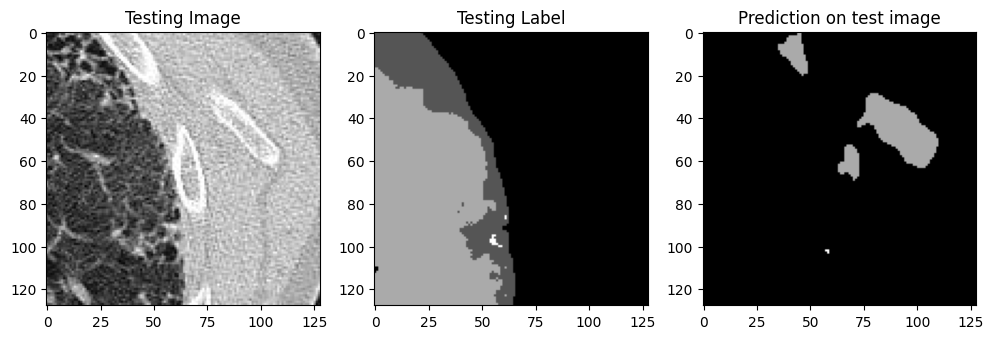

1/1 [==============================] - 0s 96ms/step


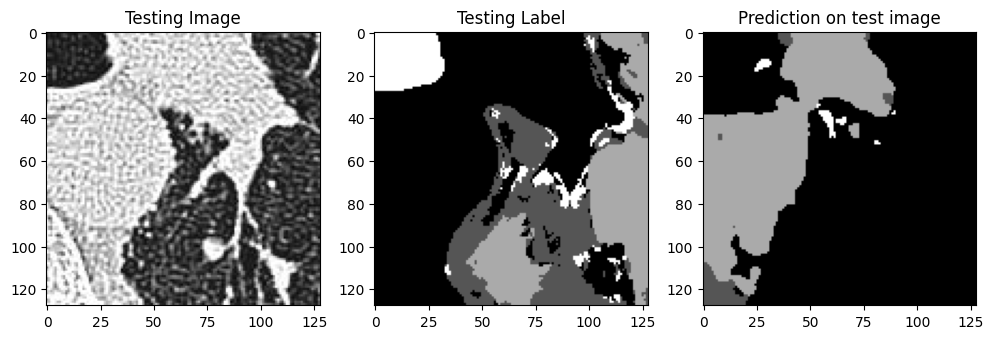

1/1 [==============================] - 0s 84ms/step


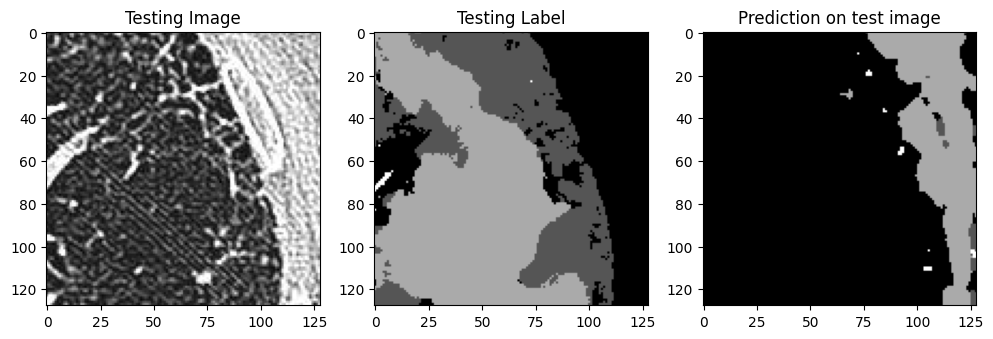

1/1 [==============================] - 0s 76ms/step


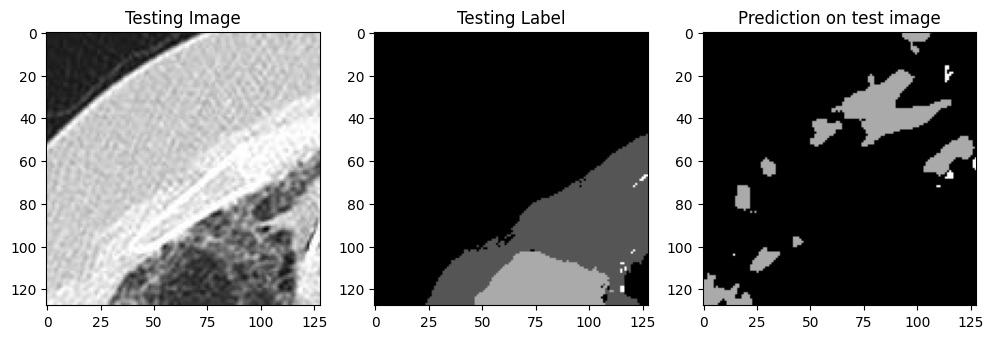

1/1 [==============================] - 0s 84ms/step


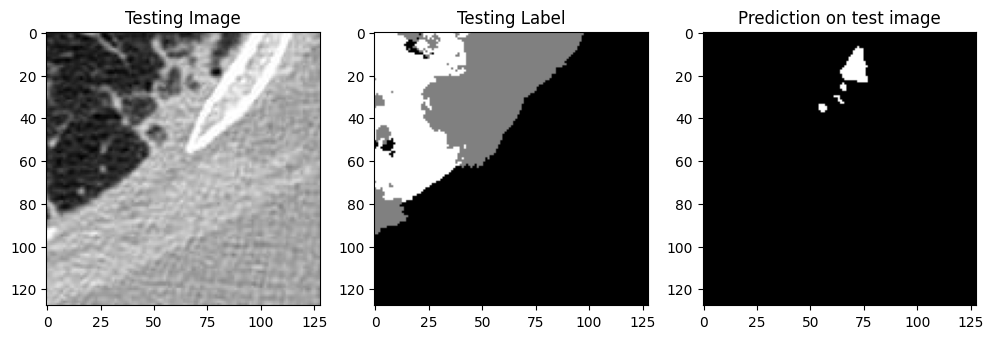

1/1 [==============================] - 0s 76ms/step


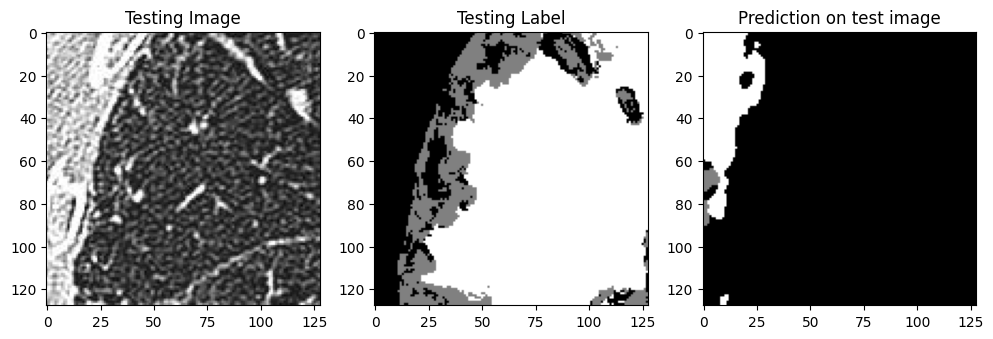

1/1 [==============================] - 0s 81ms/step


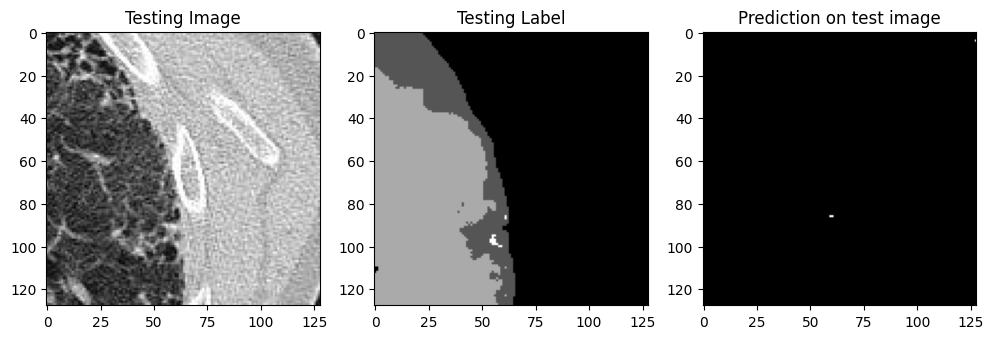

1/1 [==============================] - 0s 81ms/step


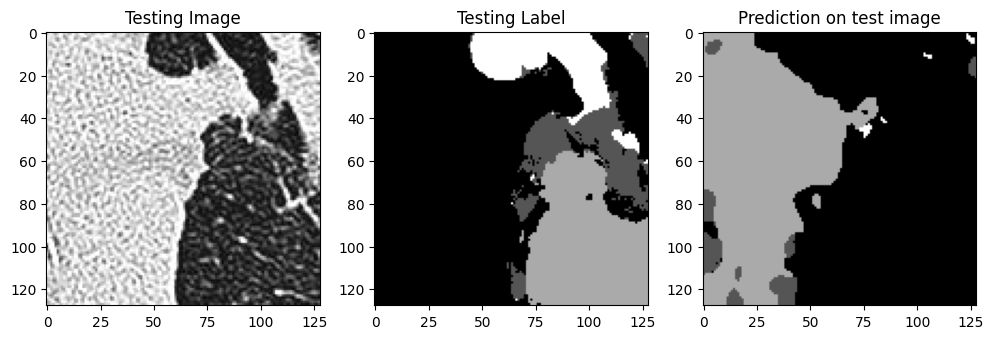

1/1 [==============================] - 0s 84ms/step


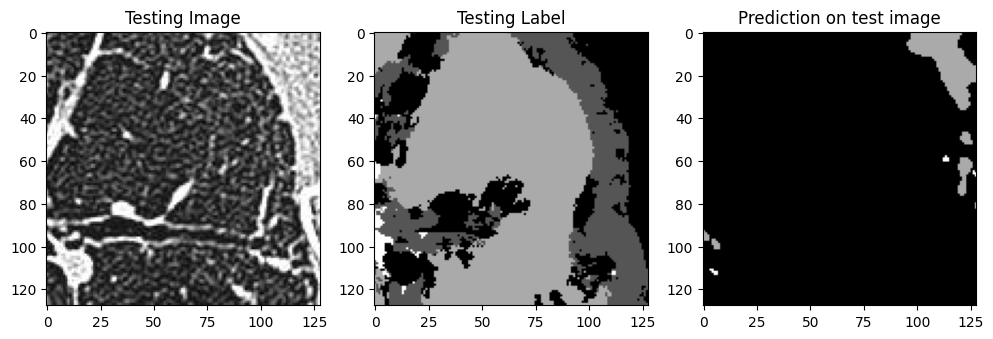

1/1 [==============================] - 0s 80ms/step


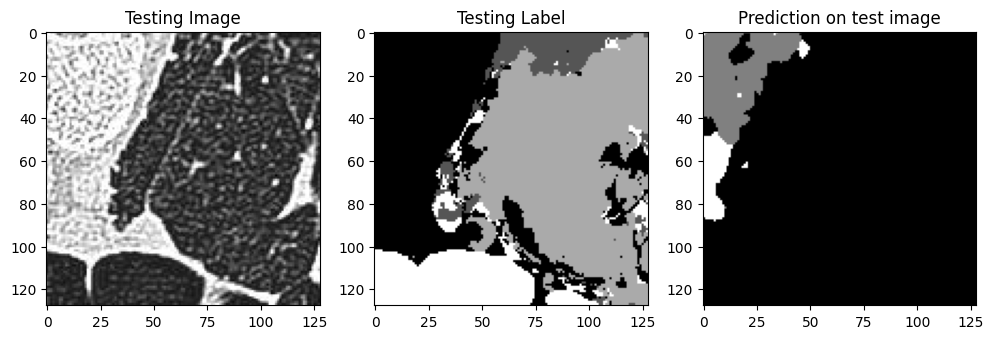

1/1 [==============================] - 0s 86ms/step


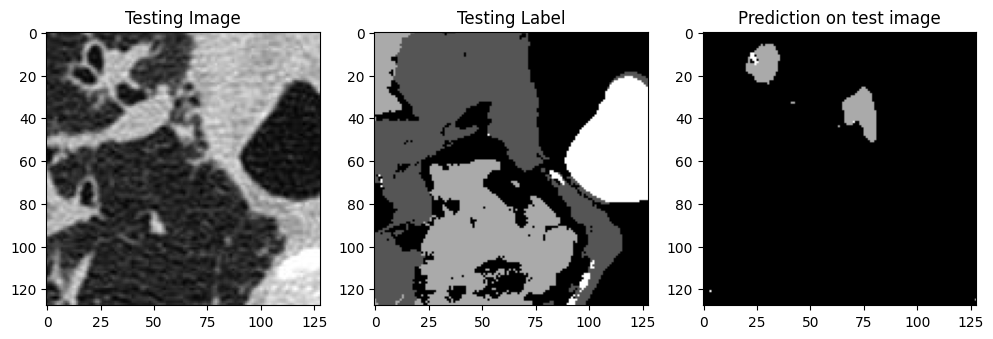

1/1 [==============================] - 0s 80ms/step


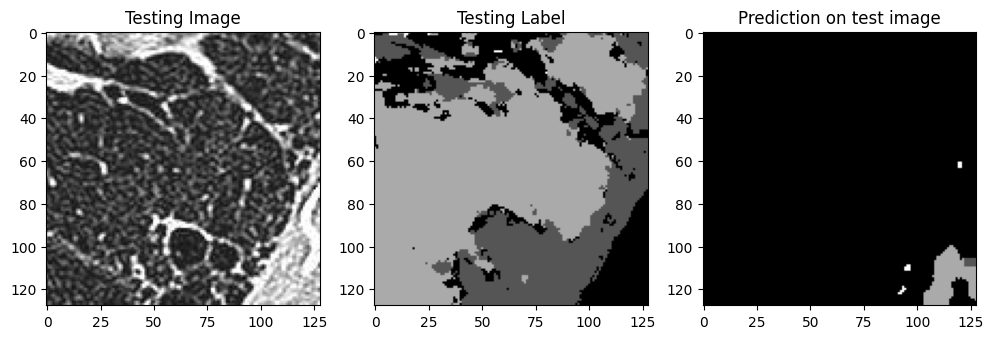

1/1 [==============================] - 0s 81ms/step


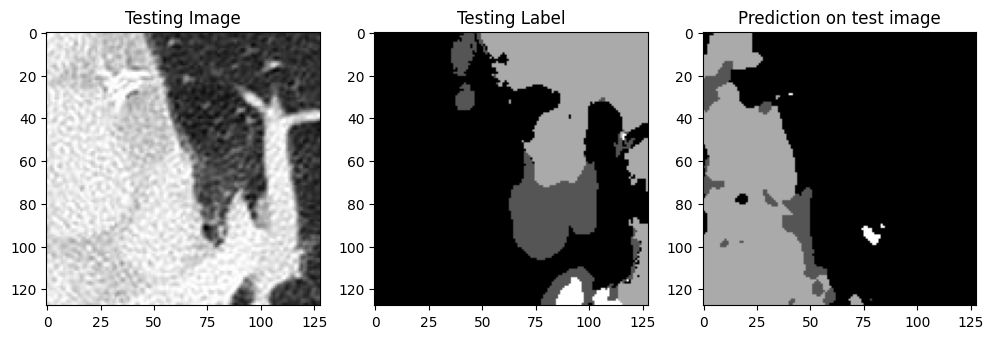

1/1 [==============================] - 0s 81ms/step


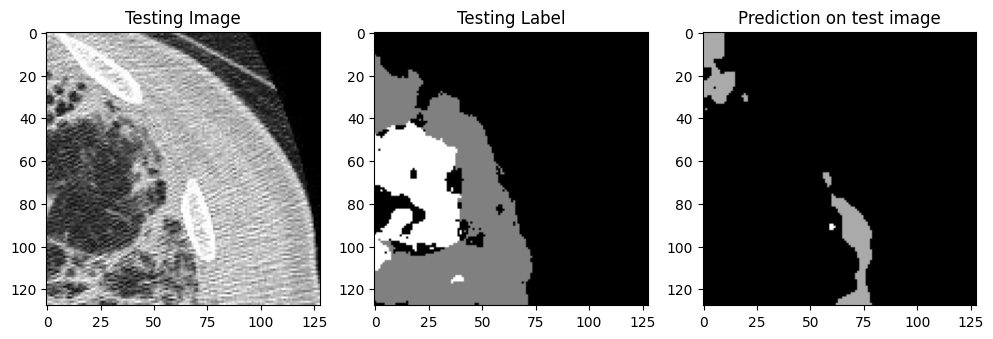

1/1 [==============================] - 0s 84ms/step


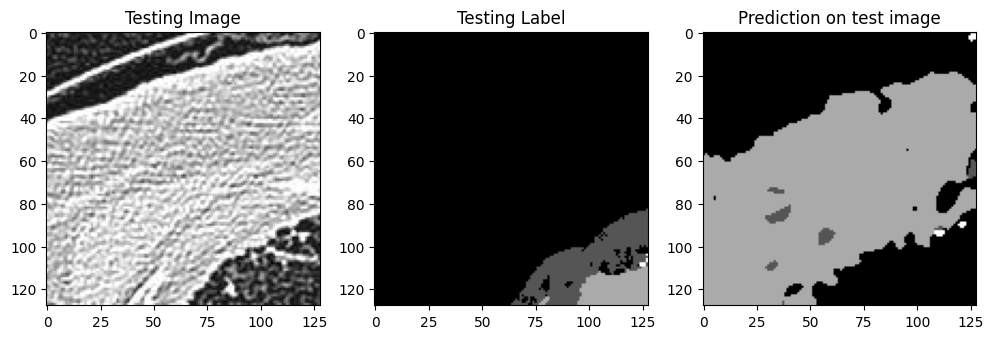

1/1 [==============================] - 0s 81ms/step


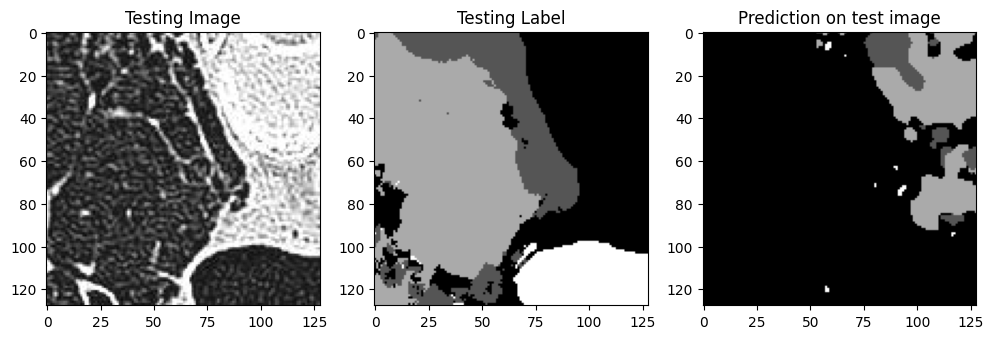

1/1 [==============================] - 0s 79ms/step


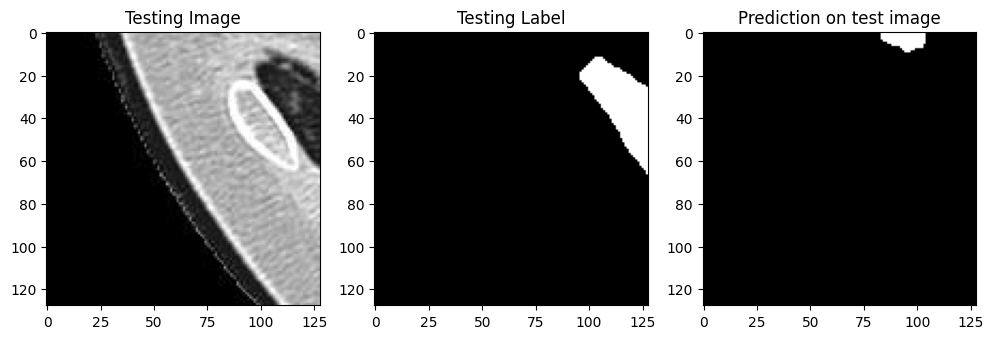

1/1 [==============================] - 0s 80ms/step


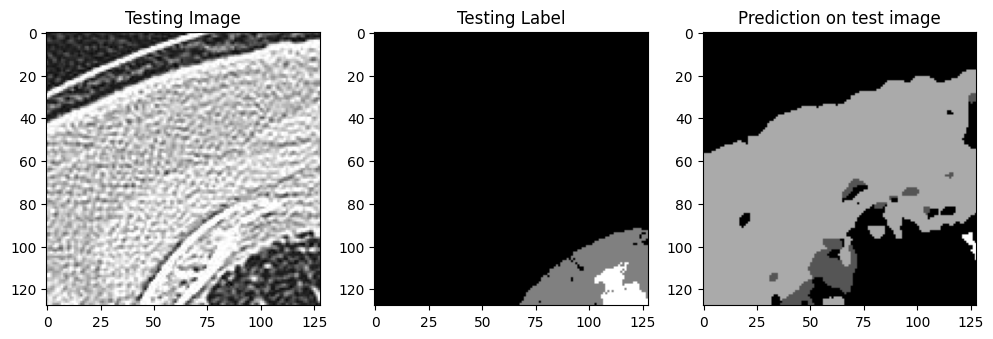

1/1 [==============================] - 0s 80ms/step


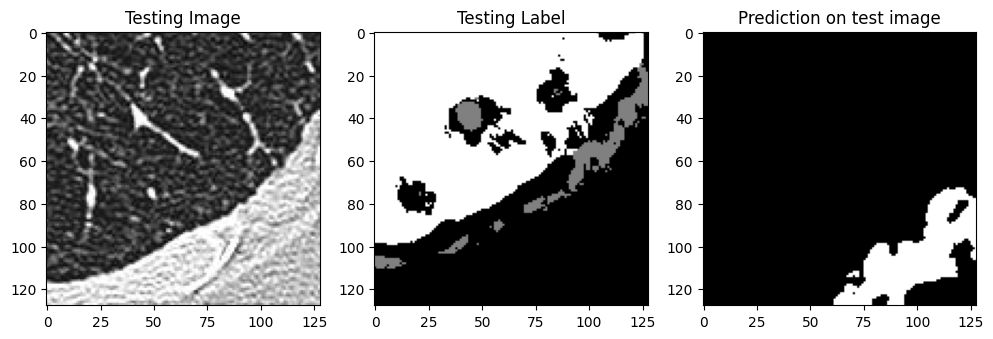

1/1 [==============================] - 0s 80ms/step


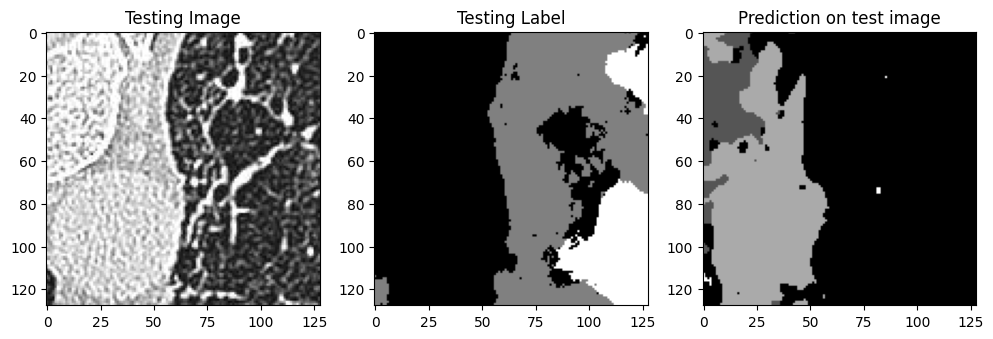

1/1 [==============================] - 0s 80ms/step


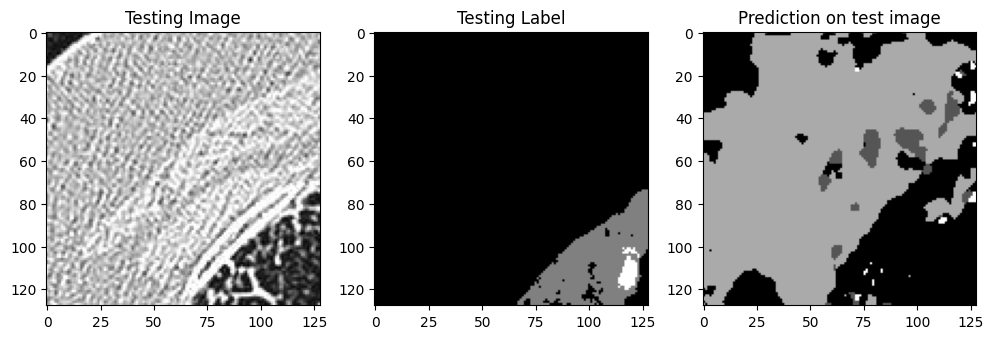

1/1 [==============================] - 0s 84ms/step


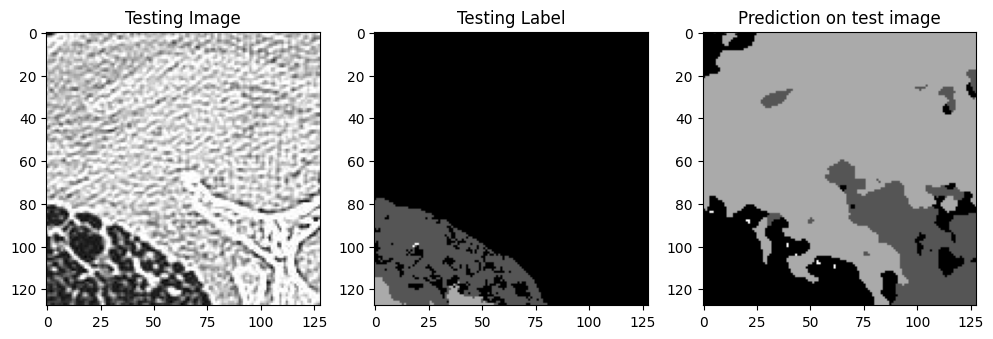

1/1 [==============================] - 0s 81ms/step


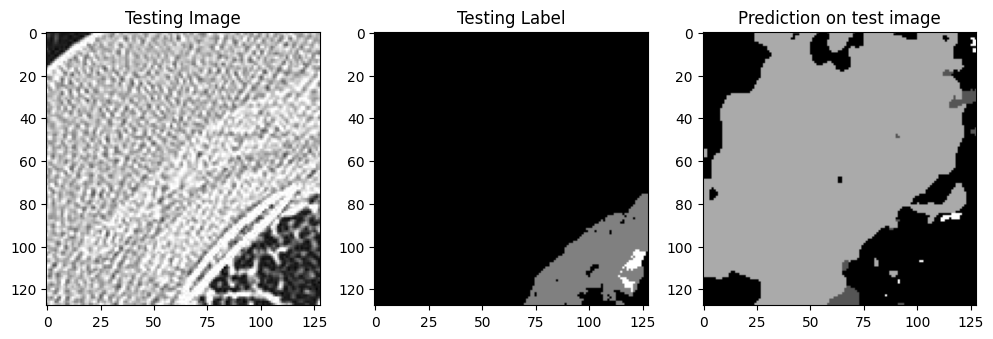

1/1 [==============================] - 0s 83ms/step


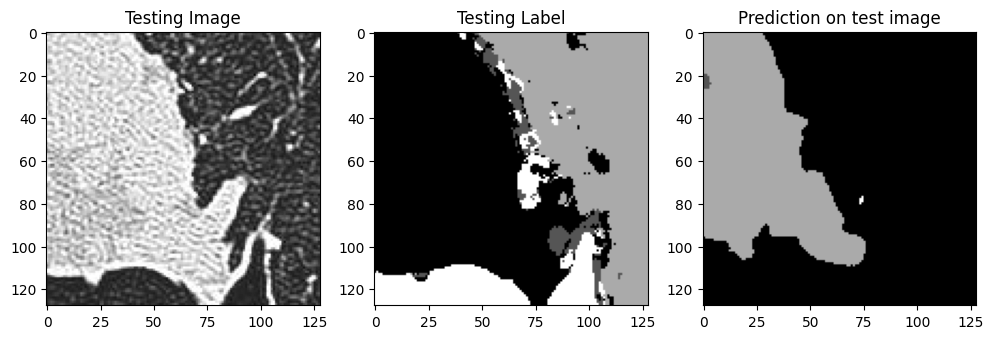

1/1 [==============================] - 0s 88ms/step


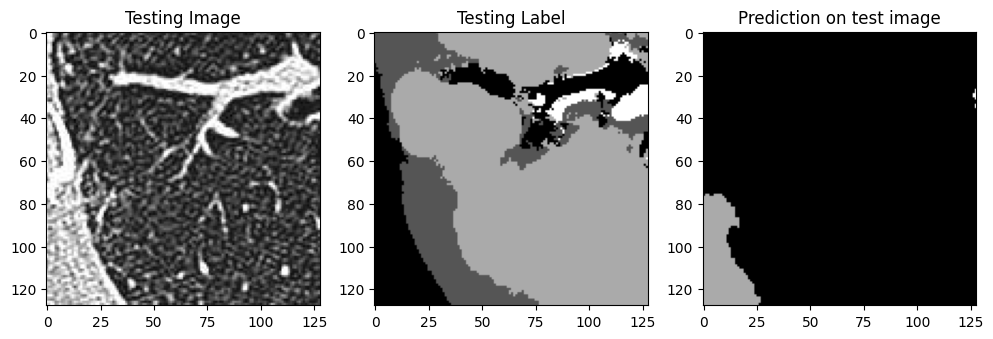

1/1 [==============================] - 0s 76ms/step


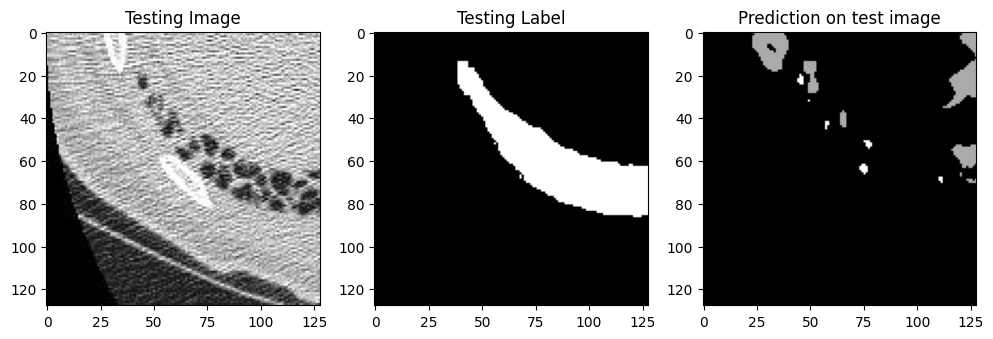

1/1 [==============================] - 0s 80ms/step


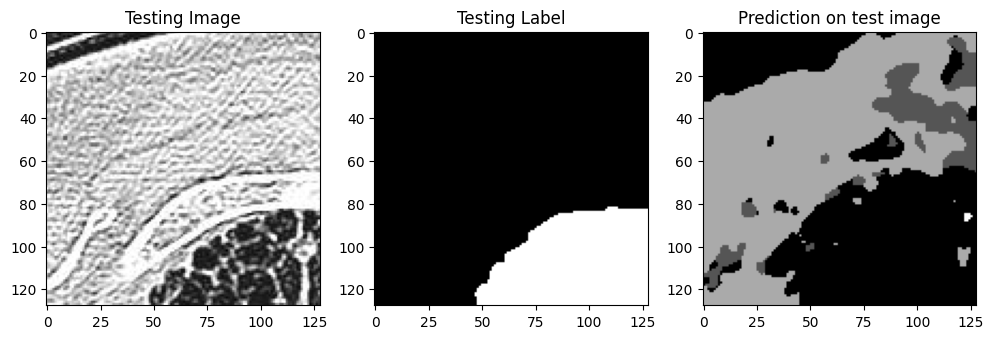

1/1 [==============================] - 0s 85ms/step


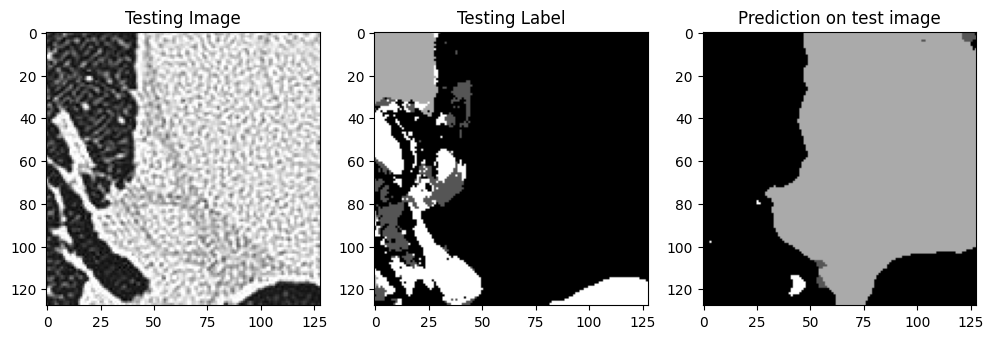

1/1 [==============================] - 0s 84ms/step


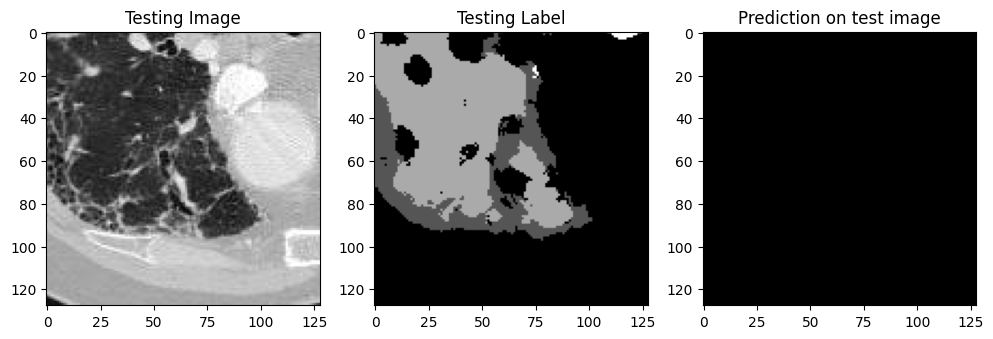

In [7]:
# Test some random images
for j in range(30):
    import random
    test_img_number = random.randint(0, len(X_test3)-1)
    test_img = X_test3[test_img_number]
    ground_truth=y_test[test_img_number]
    test_img_input=np.expand_dims(test_img, 0)
    
    test_img_input3 = preprocess_input3(test_img_input)
    
    test_pred3 = model3.predict(test_img_input3)
    test_prediction3 = np.argmax(test_pred3, axis=3)[0,:,:]
    
    
    plt.figure(figsize=(12, 8))
    plt.subplot(231)
    plt.title('Testing Image')
    plt.imshow(test_img[:,:,0], cmap='gray')
    plt.subplot(232)
    plt.title('Testing Label')
    plt.imshow(ground_truth[:,:,0], cmap='gray')
    plt.subplot(233)
    plt.title('Prediction on test image')
    plt.imshow(test_prediction3, cmap='gray')
    plt.show()

In [8]:
"""
https://github.com/Vooban/Smoothly-Blend-Image-Patches
"""

import cv2
import numpy as np

from matplotlib import pyplot as plt
import segmentation_models as sm

from smooth_tiled_predictions import predict_img_with_smooth_windowing

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 5s 2s/step


 12%|██████████▌                                                                         | 1/8 [00:05<00:40,  5.76s/it]

3/3 [==============================] - 5s 1s/step


 25%|█████████████████████                                                               | 2/8 [00:11<00:33,  5.60s/it]

3/3 [==============================] - 5s 2s/step


 38%|███████████████████████████████▌                                                    | 3/8 [00:16<00:27,  5.54s/it]

3/3 [==============================] - 5s 1s/step


 50%|██████████████████████████████████████████                                          | 4/8 [00:22<00:22,  5.51s/it]

3/3 [==============================] - 5s 1s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [00:27<00:16,  5.52s/it]

3/3 [==============================] - 5s 1s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [00:33<00:11,  5.53s/it]

3/3 [==============================] - 5s 2s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [00:38<00:05,  5.51s/it]

3/3 [==============================] - 5s 1s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:44<00:00,  5.53s/it]


segmentation_results/vgg19/segmented/1118_segmented_vgg19.tif
segmentation_results/vgg19/mask/1118_mask_vgg19.tif


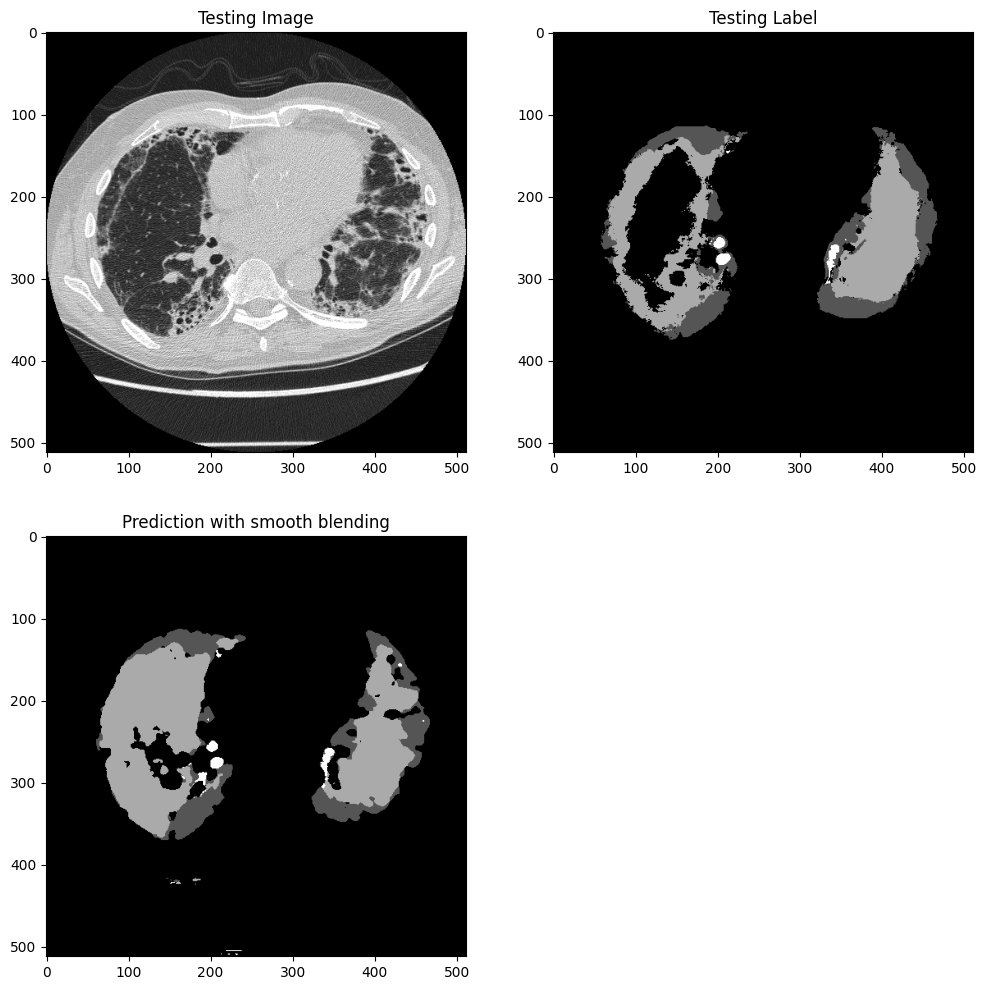

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

6/6 [==============================] - 11s 2s/step


 12%|██████████▌                                                                         | 1/8 [00:11<01:20, 11.43s/it]

6/6 [==============================] - 11s 2s/step


 25%|█████████████████████                                                               | 2/8 [00:22<01:08, 11.36s/it]

6/6 [==============================] - 10s 2s/step


 38%|███████████████████████████████▌                                                    | 3/8 [00:33<00:56, 11.22s/it]

6/6 [==============================] - 11s 2s/step


 50%|██████████████████████████████████████████                                          | 4/8 [00:45<00:44, 11.25s/it]

6/6 [==============================] - 11s 2s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [00:56<00:33, 11.26s/it]

6/6 [==============================] - 11s 2s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [01:08<00:22, 11.40s/it]

6/6 [==============================] - 11s 2s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [01:20<00:11, 11.67s/it]

6/6 [==============================] - 12s 2s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [01:32<00:00, 11.60s/it]


segmentation_results/vgg19/segmented/1118_1_segmented_vgg19.tif
segmentation_results/vgg19/mask/1118_1_mask_vgg19.tif


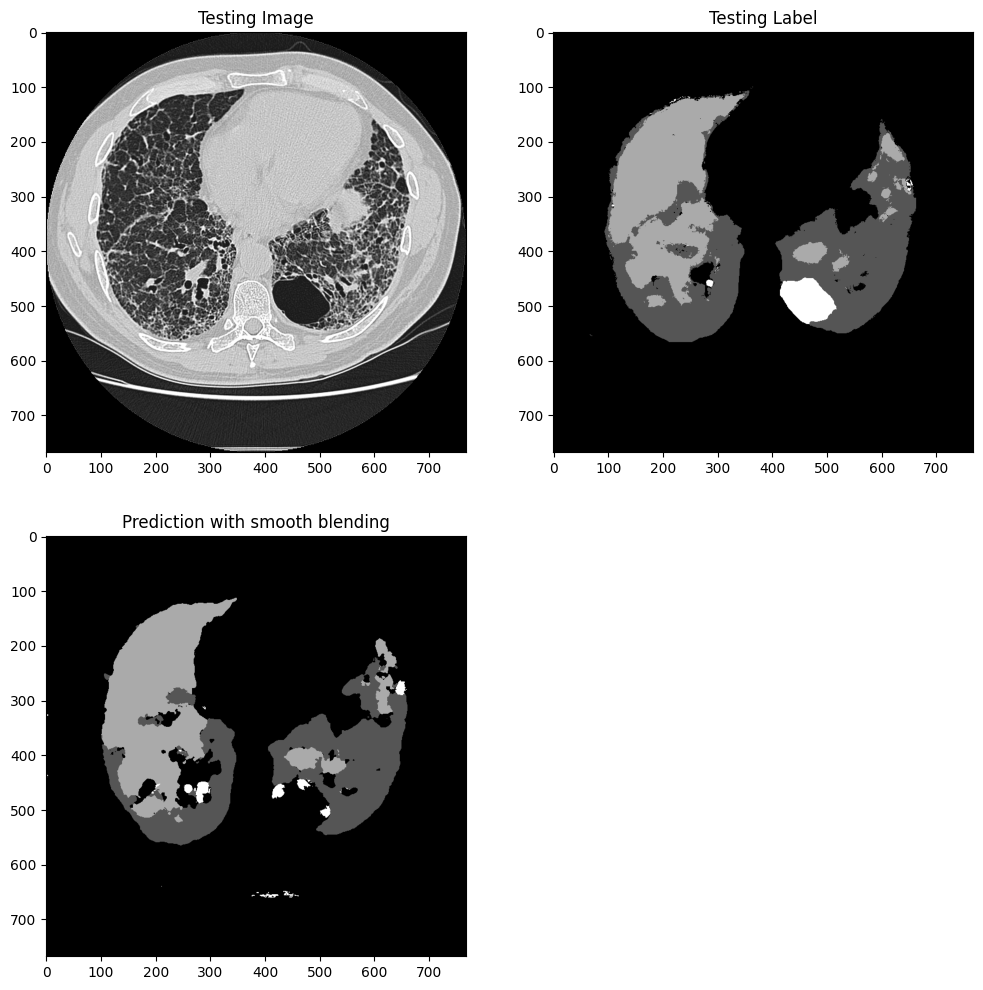

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 6s 2s/step


 12%|██████████▌                                                                         | 1/8 [00:06<00:46,  6.62s/it]

3/3 [==============================] - 6s 2s/step


 25%|█████████████████████                                                               | 2/8 [00:13<00:39,  6.62s/it]

3/3 [==============================] - 5s 2s/step


 38%|███████████████████████████████▌                                                    | 3/8 [00:19<00:32,  6.57s/it]

3/3 [==============================] - 5s 2s/step


 50%|██████████████████████████████████████████                                          | 4/8 [00:26<00:26,  6.54s/it]

3/3 [==============================] - 5s 2s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [00:32<00:19,  6.53s/it]

3/3 [==============================] - 5s 2s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [00:39<00:13,  6.50s/it]

3/3 [==============================] - 6s 2s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [00:45<00:06,  6.54s/it]

3/3 [==============================] - 6s 2s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:52<00:00,  6.55s/it]


segmentation_results/vgg19/segmented/1118_2_segmented_vgg19.tif
segmentation_results/vgg19/mask/1118_2_mask_vgg19.tif


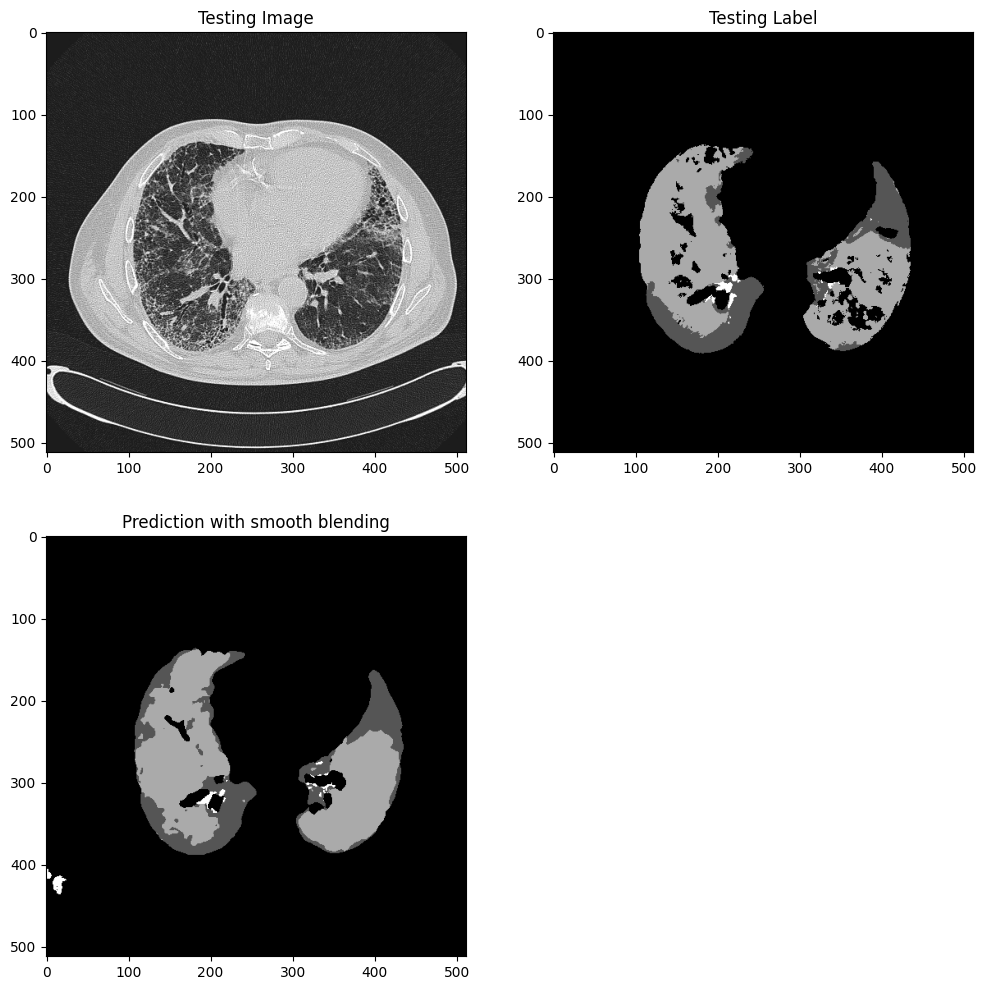

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

6/6 [==============================] - 12s 2s/step


 12%|██████████▌                                                                         | 1/8 [00:12<01:30, 12.93s/it]

6/6 [==============================] - 12s 2s/step


 25%|█████████████████████                                                               | 2/8 [00:25<01:17, 12.96s/it]

6/6 [==============================] - 12s 2s/step


 38%|███████████████████████████████▌                                                    | 3/8 [00:38<01:04, 12.96s/it]

6/6 [==============================] - 12s 2s/step


 50%|██████████████████████████████████████████                                          | 4/8 [00:51<00:51, 12.92s/it]

6/6 [==============================] - 12s 2s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [01:04<00:38, 12.88s/it]

6/6 [==============================] - 12s 2s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [01:17<00:25, 12.83s/it]

6/6 [==============================] - 12s 2s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [01:29<00:12, 12.79s/it]

6/6 [==============================] - 12s 2s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [01:42<00:00, 12.85s/it]


segmentation_results/vgg19/segmented/1119_segmented_vgg19.tif
segmentation_results/vgg19/mask/1119_mask_vgg19.tif


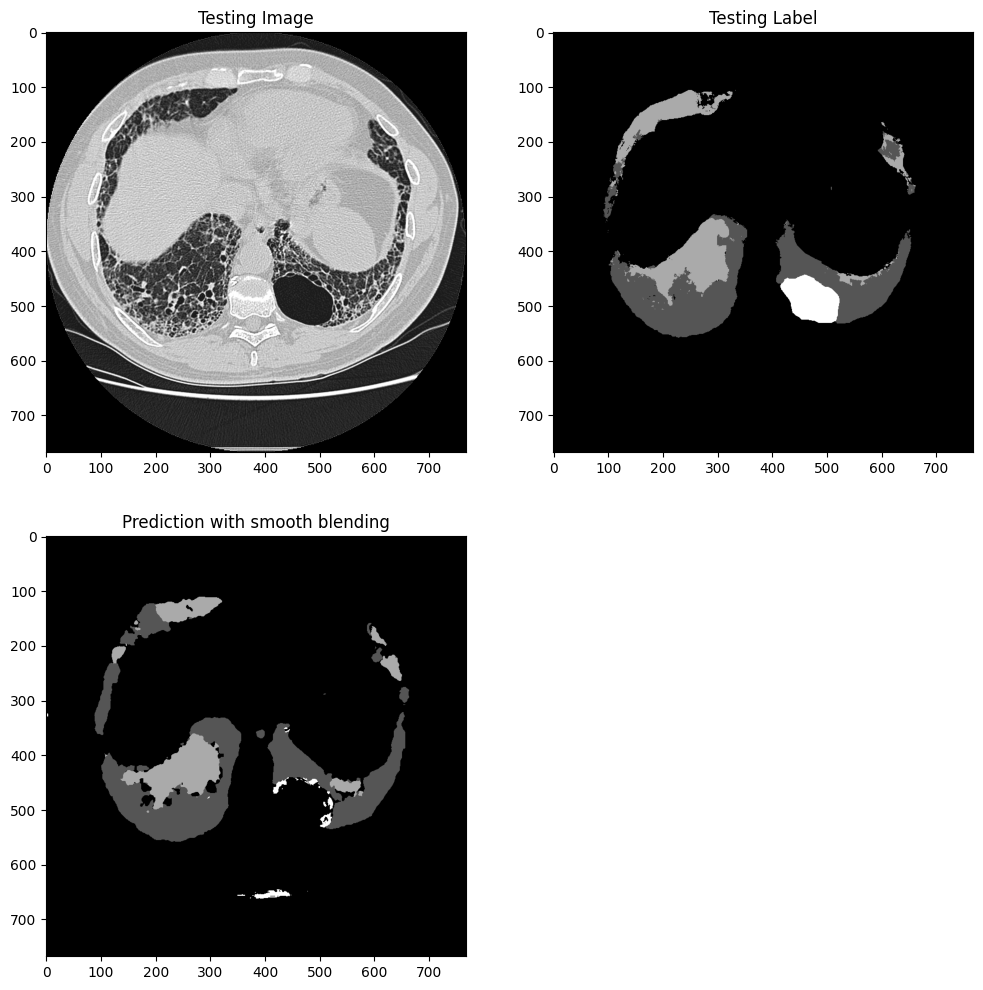

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 6s 2s/step


 12%|██████████▌                                                                         | 1/8 [00:06<00:46,  6.62s/it]

3/3 [==============================] - 6s 2s/step


 25%|█████████████████████                                                               | 2/8 [00:13<00:39,  6.59s/it]

3/3 [==============================] - 6s 2s/step


 38%|███████████████████████████████▌                                                    | 3/8 [00:20<00:34,  6.84s/it]

3/3 [==============================] - 6s 2s/step


 50%|██████████████████████████████████████████                                          | 4/8 [00:27<00:28,  7.01s/it]

3/3 [==============================] - 5s 2s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [00:34<00:20,  6.83s/it]

3/3 [==============================] - 6s 2s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [00:40<00:13,  6.74s/it]

3/3 [==============================] - 5s 2s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [00:47<00:06,  6.66s/it]

3/3 [==============================] - 5s 2s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:53<00:00,  6.71s/it]


segmentation_results/vgg19/segmented/1120_segmented_vgg19.tif
segmentation_results/vgg19/mask/1120_mask_vgg19.tif


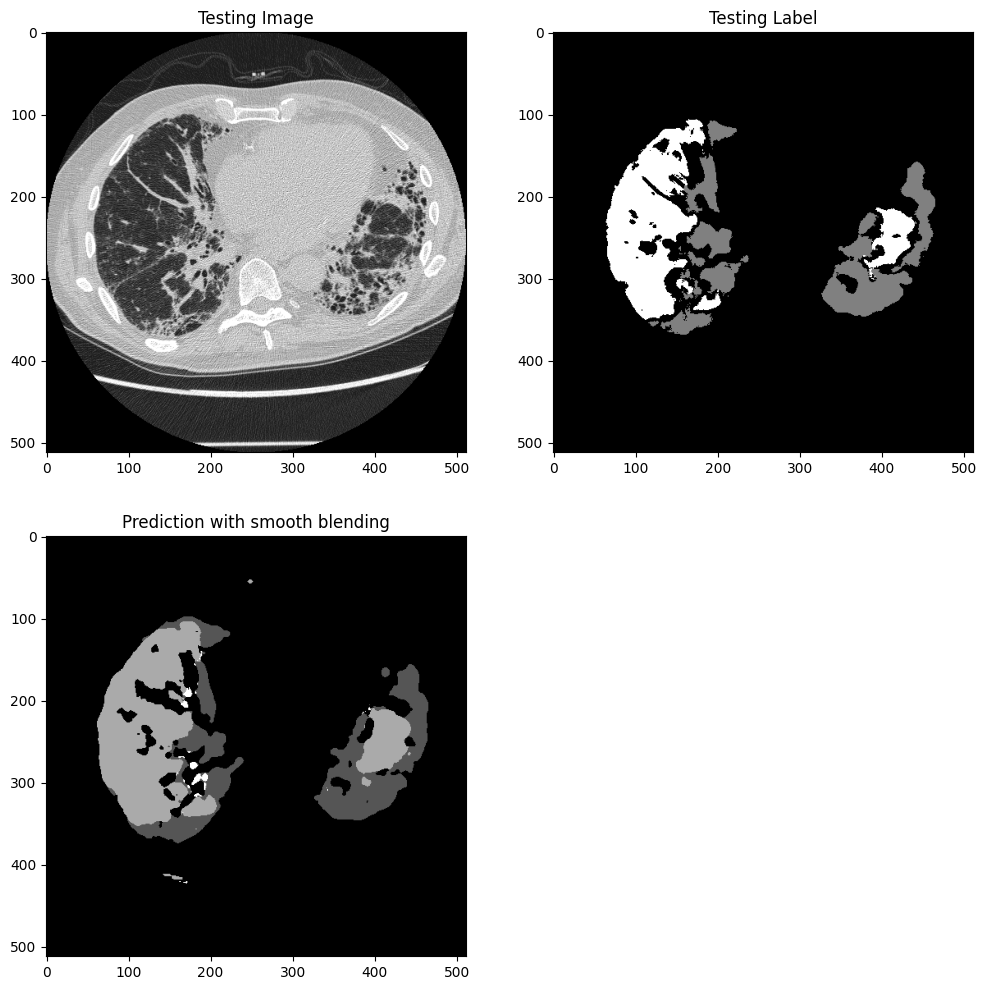

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 6s 2s/step


 12%|██████████▌                                                                         | 1/8 [00:06<00:46,  6.63s/it]

3/3 [==============================] - 6s 2s/step


 25%|█████████████████████                                                               | 2/8 [00:13<00:40,  6.70s/it]

3/3 [==============================] - 6s 2s/step


 38%|███████████████████████████████▌                                                    | 3/8 [00:19<00:33,  6.61s/it]

3/3 [==============================] - 6s 2s/step


 50%|██████████████████████████████████████████                                          | 4/8 [00:26<00:26,  6.56s/it]

3/3 [==============================] - 6s 2s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [00:32<00:19,  6.57s/it]

3/3 [==============================] - 6s 2s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [00:39<00:13,  6.57s/it]

3/3 [==============================] - 5s 2s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [00:46<00:06,  6.54s/it]

3/3 [==============================] - 5s 2s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:52<00:00,  6.56s/it]


segmentation_results/vgg19/segmented/1121_segmented_vgg19.tif
segmentation_results/vgg19/mask/1121_mask_vgg19.tif


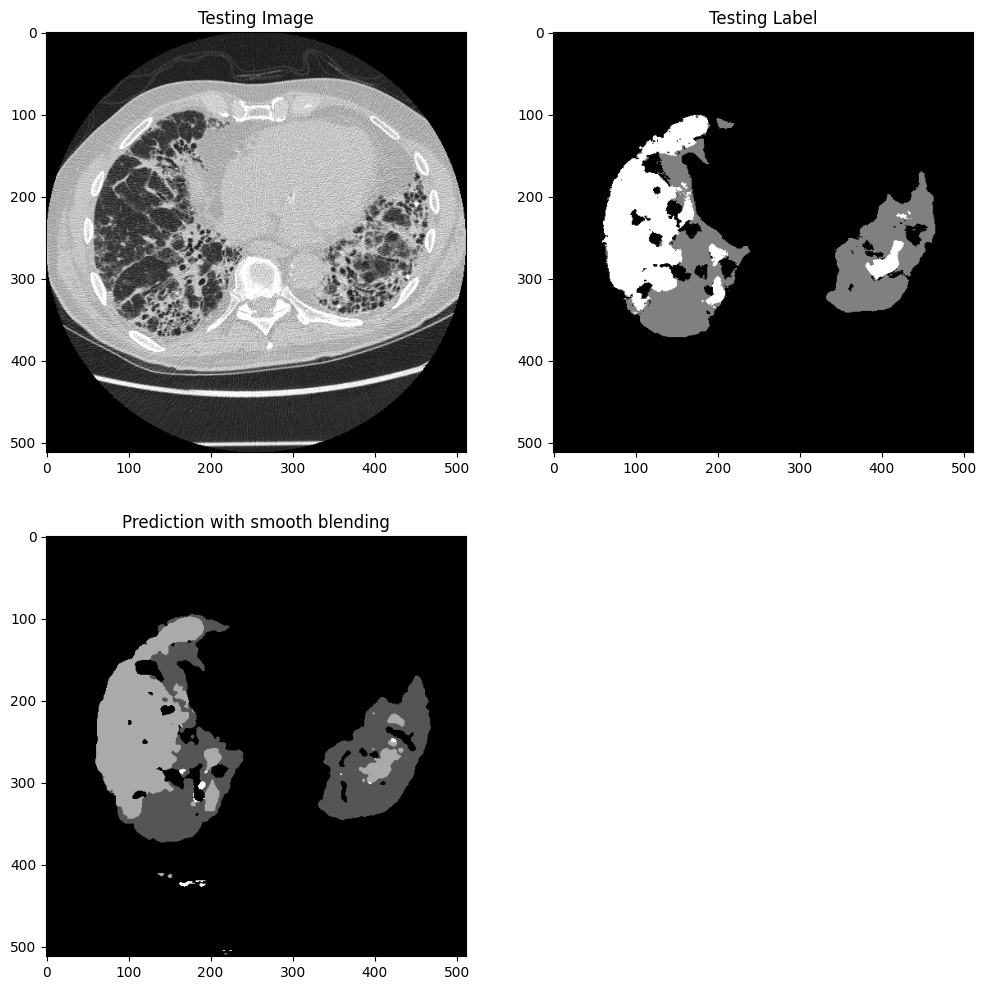

In [9]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tifffile as tiff
from keras.models import load_model
# Set your backbone, preprocess_input, patch_size, and n_classes here
BACKBONE = 'vgg19'
preprocess_input = sm.get_preprocessing(BACKBONE)
# size of patches
patch_size = 128

# Number of classes 
n_classes = 4

# Specify the directory containing the images
image_directory = "../LargeImages/Original"
mask_directory = "../LargeImages/Mask"

# Define the result directory
result_directory_mask = f'segmentation_results/{BACKBONE}/mask/'
result_directory_segmented = f'segmentation_results/{BACKBONE}/segmented/'
os.makedirs(result_directory_mask, exist_ok=True)
os.makedirs(result_directory_segmented, exist_ok=True)

# List all image files in the directory
image_files = [file for file in os.listdir(image_directory) if file.endswith(".jpg")]

# Load the model
model = load_model(f'../Segmentation_Models/{BACKBONE}/CheckPoints/weights-improvement_{BACKBONE}.hdf5', compile=False)

# Loop through each image file in the directory
for image_file in image_files:
    # Load the image
    img = cv2.imread(os.path.join(image_directory, image_file))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    input_img = preprocess_input(img)

    # Load the corresponding mask
    mask_file = os.path.splitext(image_file)[0] + ".tif"
    original_mask = cv2.imread(os.path.join(mask_directory, mask_file))
    # original_mask = cv2.cvtColor(original_mask, cv2.COLOR_BGR2RGB)
    original_mask = original_mask[:, :, 0]

    # Predict using smooth blending
    predictions_smooth = predict_img_with_smooth_windowing(
        input_img,
        window_size=patch_size,
        subdivisions=2,
        nb_classes=n_classes,
        pred_func=(
            lambda img_batch_subdiv: model.predict((img_batch_subdiv))
        )
    )

    final_prediction = np.argmax(predictions_smooth, axis=2).astype(np.uint8)

    # Save the final prediction and original mask
    result_image_file = f'{result_directory_segmented}{os.path.splitext(image_file)[0]}_segmented_{BACKBONE}.tif'
    result_mask_file = f'{result_directory_mask}{os.path.splitext(image_file)[0]}_mask_{BACKBONE}.tif'
    print(result_image_file)
    print(result_mask_file)
    tiff.imwrite(result_image_file, final_prediction)
    tiff.imwrite(result_mask_file, original_mask)
    # Display the images if needed
    plt.figure(figsize=(12, 12))
    plt.subplot(221)
    plt.title('Testing Image')
    plt.imshow(img)
    plt.subplot(222)
    plt.title('Testing Label')
    plt.imshow(original_mask, cmap = 'gray')
    plt.subplot(223)
    plt.title('Prediction with smooth blending')
    plt.imshow(final_prediction, cmap= 'gray')
    plt.show()


  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 4s 1s/step


 12%|██████████▌                                                                         | 1/8 [00:04<00:30,  4.38s/it]

3/3 [==============================] - 4s 1s/step


 25%|█████████████████████                                                               | 2/8 [00:08<00:25,  4.29s/it]

3/3 [==============================] - 4s 1s/step


 38%|███████████████████████████████▌                                                    | 3/8 [00:12<00:21,  4.31s/it]

3/3 [==============================] - 4s 1s/step


 50%|██████████████████████████████████████████                                          | 4/8 [00:17<00:17,  4.36s/it]

3/3 [==============================] - 4s 1s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [00:22<00:13,  4.64s/it]

3/3 [==============================] - 4s 1s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [00:27<00:09,  4.82s/it]

3/3 [==============================] - 5s 1s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [00:32<00:04,  4.98s/it]

3/3 [==============================] - 5s 1s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:38<00:00,  4.78s/it]


segmentation_results_not_tested/vgg19/1156_segmented_vgg19.tif


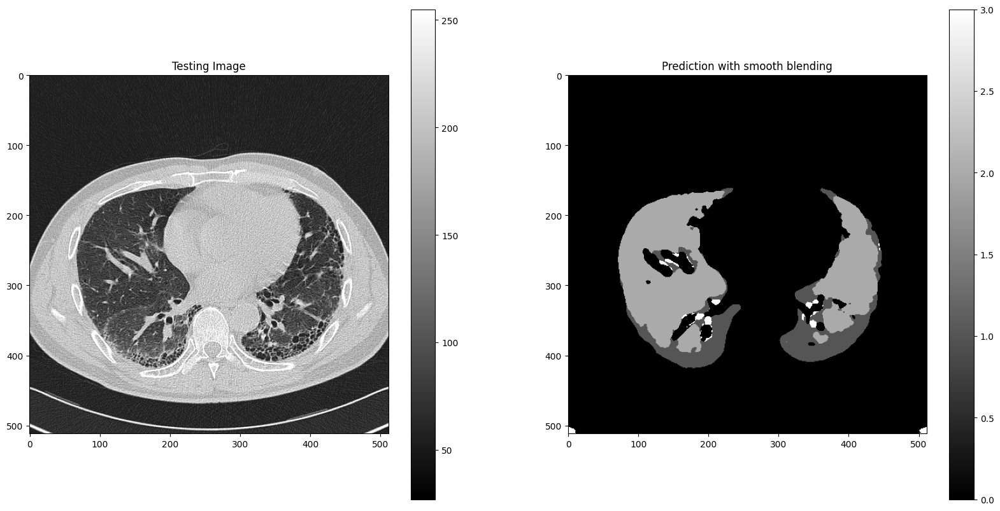

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 5s 2s/step


 12%|██████████▌                                                                         | 1/8 [00:05<00:41,  5.95s/it]

3/3 [==============================] - 6s 2s/step


 25%|█████████████████████                                                               | 2/8 [00:12<00:37,  6.32s/it]

3/3 [==============================] - 5s 2s/step


 38%|███████████████████████████████▌                                                    | 3/8 [00:18<00:31,  6.27s/it]

3/3 [==============================] - 5s 2s/step


 50%|██████████████████████████████████████████                                          | 4/8 [00:24<00:24,  6.05s/it]

3/3 [==============================] - 5s 1s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [00:30<00:17,  5.90s/it]

3/3 [==============================] - 5s 2s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [00:35<00:11,  5.79s/it]

3/3 [==============================] - 5s 2s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [00:41<00:05,  5.78s/it]

3/3 [==============================] - 5s 2s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:47<00:00,  5.94s/it]


segmentation_results_not_tested/vgg19/1157_segmented_vgg19.tif


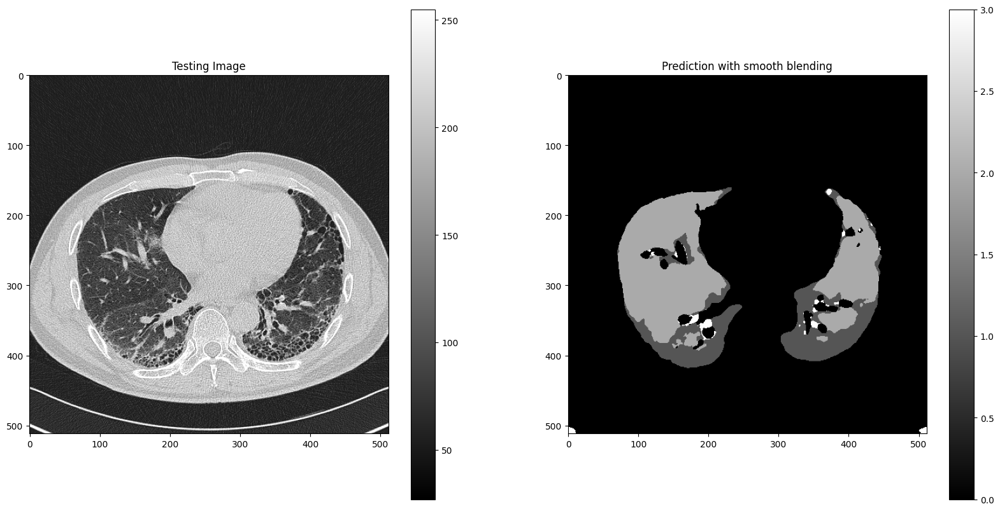

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 6s 2s/step


 12%|██████████▌                                                                         | 1/8 [00:06<00:46,  6.63s/it]

3/3 [==============================] - 7s 2s/step


 25%|█████████████████████                                                               | 2/8 [00:14<00:43,  7.26s/it]

3/3 [==============================] - 6s 2s/step


 38%|███████████████████████████████▌                                                    | 3/8 [00:21<00:36,  7.24s/it]

3/3 [==============================] - 6s 2s/step


 50%|██████████████████████████████████████████                                          | 4/8 [00:28<00:28,  7.14s/it]

3/3 [==============================] - 6s 2s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [00:34<00:20,  6.88s/it]

3/3 [==============================] - 6s 2s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [00:41<00:13,  6.71s/it]

3/3 [==============================] - 6s 2s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [00:47<00:06,  6.59s/it]

3/3 [==============================] - 6s 2s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:54<00:00,  6.83s/it]


segmentation_results_not_tested/vgg19/1158_segmented_vgg19.tif


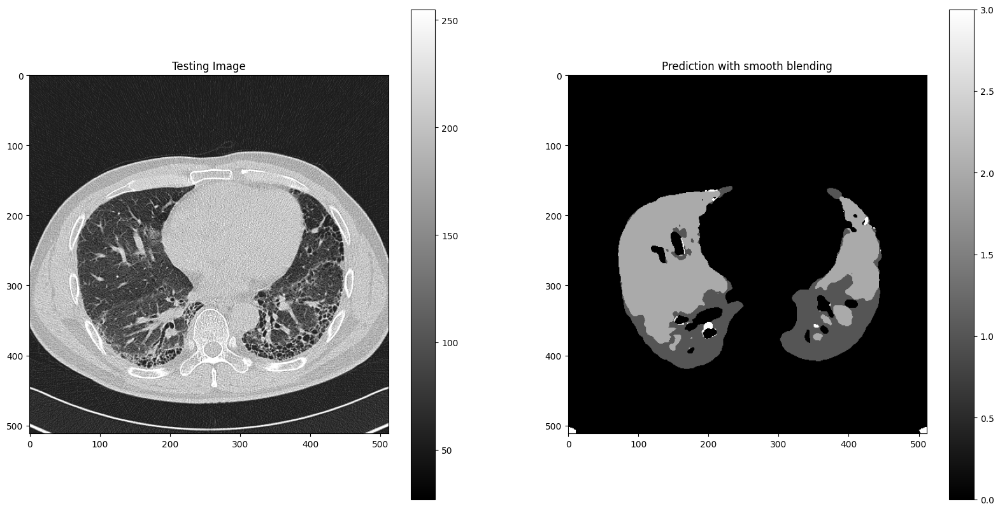

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 6s 2s/step


 12%|██████████▌                                                                         | 1/8 [00:06<00:47,  6.74s/it]

3/3 [==============================] - 17s 6s/step


 25%|█████████████████████                                                               | 2/8 [00:25<01:21, 13.62s/it]

3/3 [==============================] - 16s 5s/step


 38%|███████████████████████████████▌                                                    | 3/8 [00:42<01:16, 15.20s/it]

3/3 [==============================] - 18s 6s/step


 50%|██████████████████████████████████████████                                          | 4/8 [01:03<01:11, 17.77s/it]

3/3 [==============================] - 23s 7s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [01:28<01:00, 20.06s/it]

3/3 [==============================] - 33s 9s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [02:02<00:50, 25.08s/it]

3/3 [==============================] - 30s 9s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [02:35<00:27, 27.52s/it]

3/3 [==============================] - 33s 10s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [03:19<00:00, 24.91s/it]


segmentation_results_not_tested/vgg19/1158_1_segmented_vgg19.tif


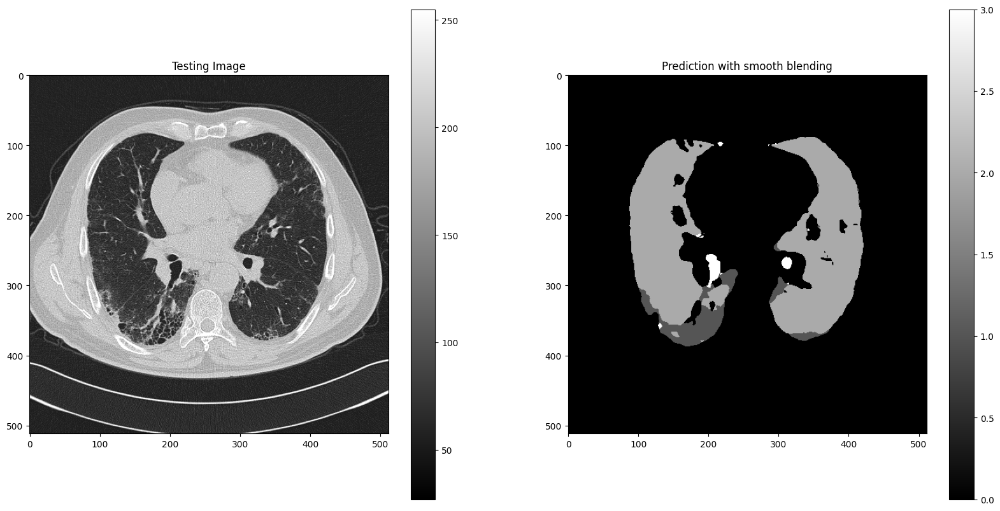

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 34s 10s/step


 12%|██████████▌                                                                         | 1/8 [00:36<04:14, 36.34s/it]

3/3 [==============================] - 34s 11s/step


 25%|█████████████████████                                                               | 2/8 [01:19<04:03, 40.52s/it]

3/3 [==============================] - 34s 10s/step


 38%|███████████████████████████████▌                                                    | 3/8 [01:55<03:11, 38.31s/it]

3/3 [==============================] - 10s 3s/step


 50%|██████████████████████████████████████████                                          | 4/8 [02:06<01:50, 27.70s/it]

3/3 [==============================] - 7s 2s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [02:14<01:01, 20.49s/it]

3/3 [==============================] - 6s 2s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [02:21<00:31, 15.95s/it]

3/3 [==============================] - 6s 2s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [02:28<00:12, 12.83s/it]

3/3 [==============================] - 6s 2s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [02:35<00:00, 19.39s/it]


segmentation_results_not_tested/vgg19/1158_2_segmented_vgg19.tif


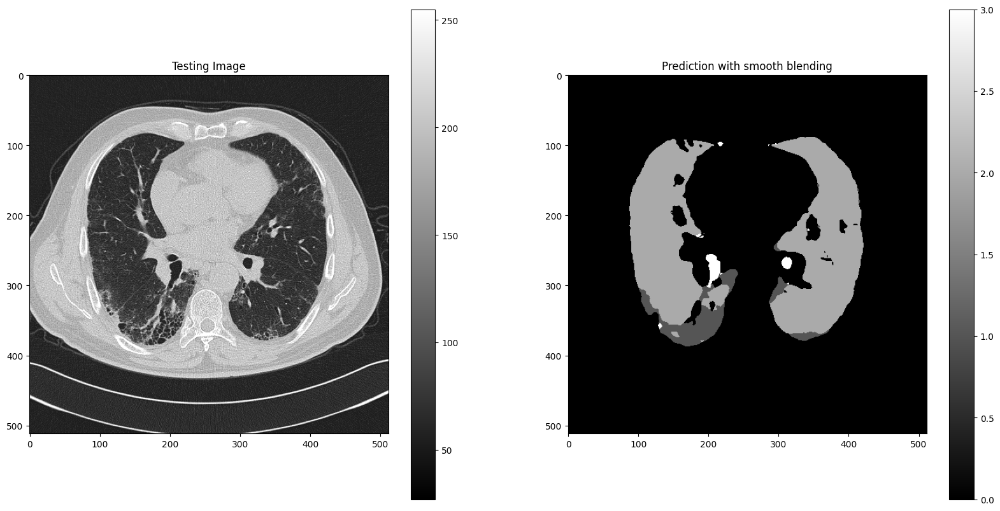

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 8s 3s/step


 12%|██████████▌                                                                         | 1/8 [00:09<01:06,  9.50s/it]

3/3 [==============================] - 7s 2s/step


 25%|█████████████████████                                                               | 2/8 [00:18<00:53,  8.94s/it]

3/3 [==============================] - 7s 2s/step


 38%|███████████████████████████████▌                                                    | 3/8 [00:25<00:41,  8.39s/it]

3/3 [==============================] - 6s 2s/step


 50%|██████████████████████████████████████████                                          | 4/8 [00:32<00:31,  7.86s/it]

3/3 [==============================] - 7s 2s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [00:40<00:23,  7.83s/it]

3/3 [==============================] - 7s 2s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [00:48<00:15,  7.85s/it]

3/3 [==============================] - 6s 2s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [00:55<00:07,  7.65s/it]

3/3 [==============================] - 9s 3s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [01:05<00:00,  8.23s/it]


segmentation_results_not_tested/vgg19/1159_segmented_vgg19.tif


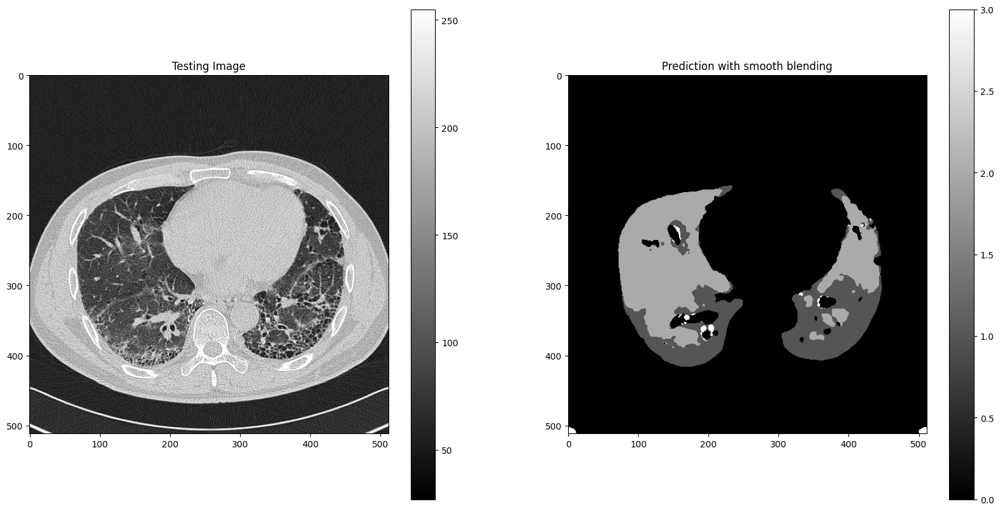

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 16s 5s/step


 12%|██████████▌                                                                         | 1/8 [00:17<02:02, 17.48s/it]

3/3 [==============================] - 16s 5s/step


 25%|█████████████████████                                                               | 2/8 [00:34<01:42, 17.08s/it]

3/3 [==============================] - 16s 5s/step


 38%|███████████████████████████████▌                                                    | 3/8 [00:50<01:24, 16.90s/it]

3/3 [==============================] - 16s 5s/step


 50%|██████████████████████████████████████████                                          | 4/8 [01:07<01:07, 16.83s/it]

3/3 [==============================] - 16s 5s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [01:24<00:50, 16.73s/it]

3/3 [==============================] - 18s 5s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [01:43<00:35, 17.63s/it]

3/3 [==============================] - 24s 8s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [02:08<00:20, 20.16s/it]

3/3 [==============================] - 30s 9s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [02:39<00:00, 20.00s/it]


segmentation_results_not_tested/vgg19/1159_1_segmented_vgg19.tif


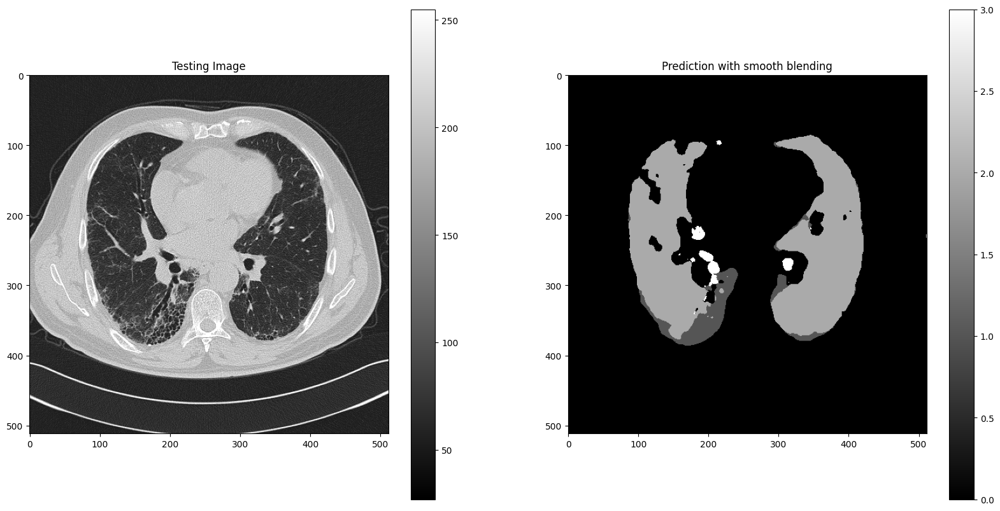

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 32s 10s/step


 12%|██████████▌                                                                         | 1/8 [00:33<03:53, 33.37s/it]

3/3 [==============================] - 29s 9s/step


 25%|█████████████████████                                                               | 2/8 [01:04<03:12, 32.03s/it]

3/3 [==============================] - 32s 10s/step


 38%|███████████████████████████████▌                                                    | 3/8 [01:38<02:45, 33.05s/it]

3/3 [==============================] - 31s 10s/step


 50%|██████████████████████████████████████████                                          | 4/8 [02:11<02:12, 33.13s/it]

3/3 [==============================] - 32s 10s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [02:55<01:50, 36.76s/it]

3/3 [==============================] - 33s 10s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [03:29<01:11, 35.87s/it]

3/3 [==============================] - 8s 2s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [03:38<00:27, 27.04s/it]

3/3 [==============================] - 7s 2s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [03:45<00:00, 28.24s/it]


segmentation_results_not_tested/vgg19/1160_segmented_vgg19.tif


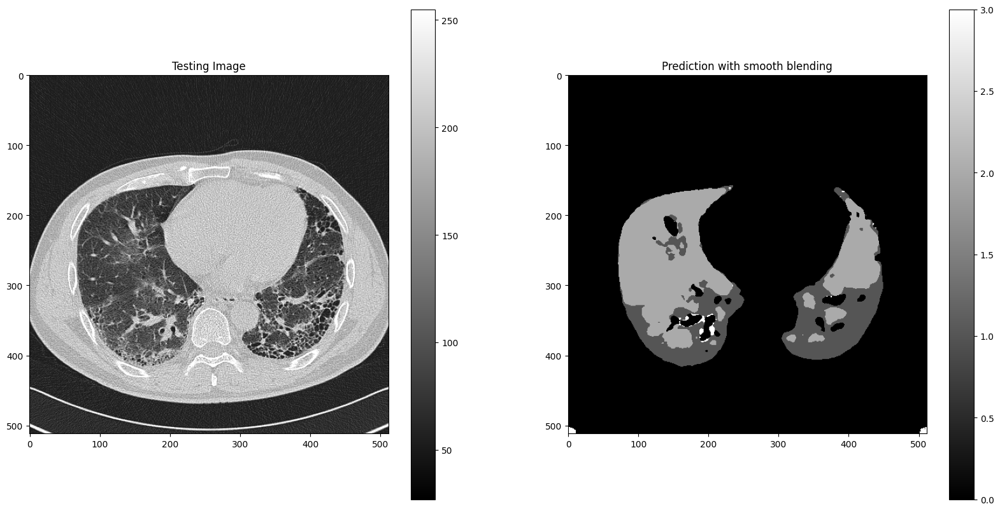

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 6s 2s/step


 12%|██████████▌                                                                         | 1/8 [00:07<00:51,  7.29s/it]

3/3 [==============================] - 7s 2s/step


 25%|█████████████████████                                                               | 2/8 [00:14<00:44,  7.47s/it]

3/3 [==============================] - 7s 2s/step


 38%|███████████████████████████████▌                                                    | 3/8 [00:22<00:37,  7.47s/it]

3/3 [==============================] - 6s 2s/step


 50%|██████████████████████████████████████████                                          | 4/8 [00:29<00:29,  7.27s/it]

3/3 [==============================] - 6s 2s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [00:35<00:21,  7.03s/it]

3/3 [==============================] - 6s 2s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [00:42<00:13,  6.95s/it]

3/3 [==============================] - 7s 2s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [00:50<00:07,  7.20s/it]

3/3 [==============================] - 7s 2s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:58<00:00,  7.29s/it]


segmentation_results_not_tested/vgg19/1161_segmented_vgg19.tif


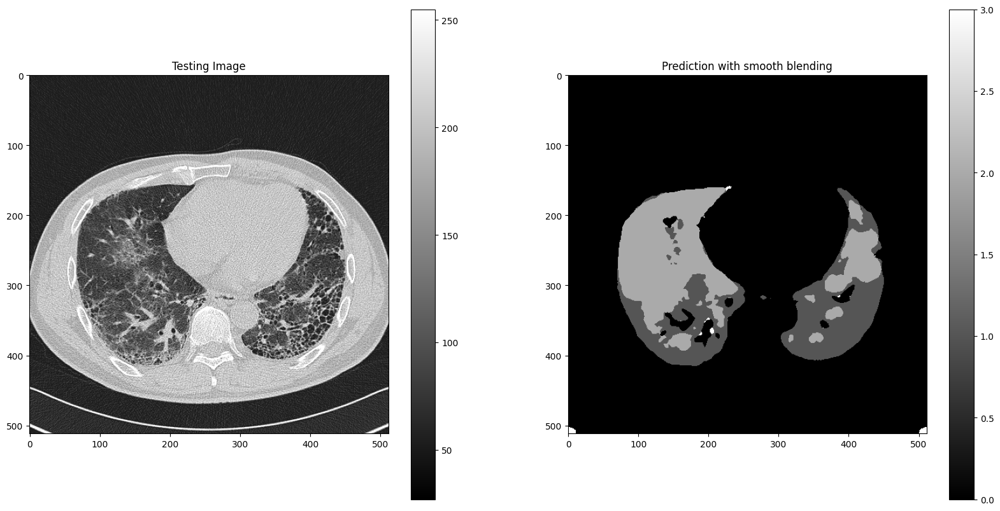

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 6s 2s/step


 12%|██████████▌                                                                         | 1/8 [00:07<00:49,  7.11s/it]

3/3 [==============================] - 6s 2s/step


 25%|█████████████████████                                                               | 2/8 [00:13<00:41,  6.97s/it]

3/3 [==============================] - 6s 2s/step


 38%|███████████████████████████████▌                                                    | 3/8 [00:20<00:34,  6.99s/it]

3/3 [==============================] - 6s 2s/step


 50%|██████████████████████████████████████████                                          | 4/8 [00:27<00:27,  6.94s/it]

3/3 [==============================] - 7s 2s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [00:35<00:21,  7.17s/it]

3/3 [==============================] - 12s 5s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [00:48<00:18,  9.34s/it]

3/3 [==============================] - 16s 5s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [01:05<00:11, 11.80s/it]

3/3 [==============================] - 17s 6s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [01:24<00:00, 10.53s/it]


segmentation_results_not_tested/vgg19/1161_1_segmented_vgg19.tif


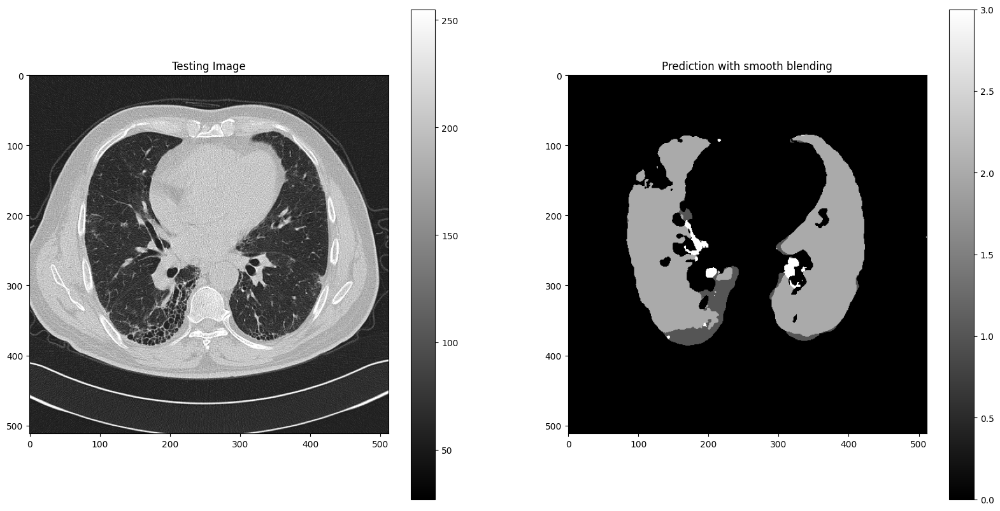

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 20s 7s/step


 12%|██████████▌                                                                         | 1/8 [00:21<02:28, 21.15s/it]

3/3 [==============================] - 30s 9s/step


 25%|█████████████████████                                                               | 2/8 [00:52<02:42, 27.14s/it]

3/3 [==============================] - 29s 8s/step


 38%|███████████████████████████████▌                                                    | 3/8 [01:36<02:53, 34.69s/it]

3/3 [==============================] - 28s 8s/step


 50%|██████████████████████████████████████████                                          | 4/8 [02:05<02:10, 32.72s/it]

3/3 [==============================] - 30s 10s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [02:37<01:37, 32.49s/it]

3/3 [==============================] - 32s 10s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [03:11<01:05, 32.86s/it]

3/3 [==============================] - 32s 10s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [03:45<00:33, 33.08s/it]

3/3 [==============================] - 31s 10s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [04:18<00:00, 32.28s/it]


segmentation_results_not_tested/vgg19/1162_segmented_vgg19.tif


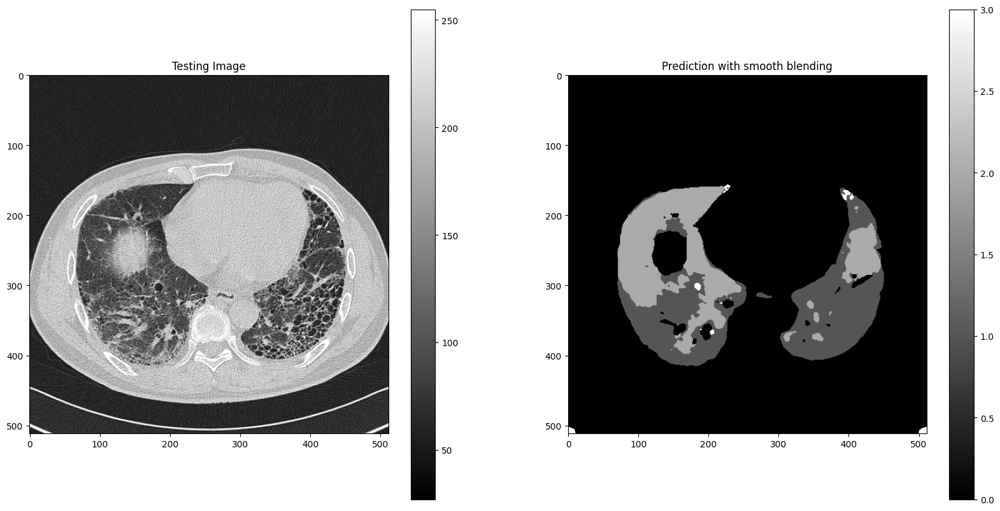

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 27s 9s/step


 12%|██████████▌                                                                         | 1/8 [00:43<05:01, 43.03s/it]

3/3 [==============================] - 26s 5s/step


 25%|█████████████████████                                                               | 2/8 [01:10<03:22, 33.68s/it]

3/3 [==============================] - 8s 2s/step


 38%|███████████████████████████████▌                                                    | 3/8 [01:18<01:51, 22.34s/it]

3/3 [==============================] - 7s 2s/step


 50%|██████████████████████████████████████████                                          | 4/8 [01:27<01:07, 16.84s/it]

3/3 [==============================] - 7s 2s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [01:35<00:41, 13.85s/it]

3/3 [==============================] - 8s 2s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [01:44<00:24, 12.05s/it]

3/3 [==============================] - 7s 2s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [01:52<00:10, 10.86s/it]

3/3 [==============================] - 7s 2s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [02:01<00:00, 15.16s/it]


segmentation_results_not_tested/vgg19/1163_segmented_vgg19.tif


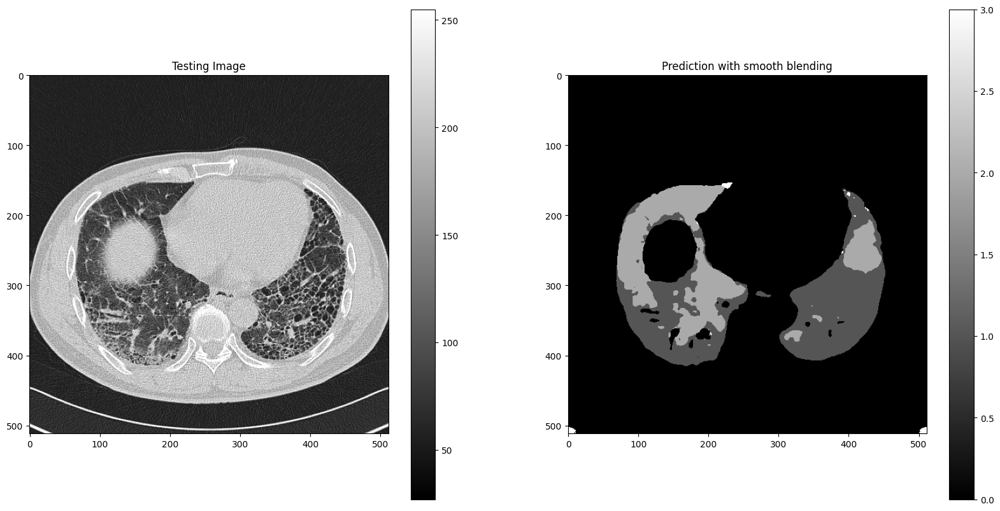

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 7s 2s/step


 12%|██████████▌                                                                         | 1/8 [00:08<00:56,  8.03s/it]

3/3 [==============================] - 7s 2s/step


 25%|█████████████████████                                                               | 2/8 [00:16<00:48,  8.07s/it]

3/3 [==============================] - 7s 2s/step


 38%|███████████████████████████████▌                                                    | 3/8 [00:24<00:40,  8.14s/it]

3/3 [==============================] - 7s 2s/step


 50%|██████████████████████████████████████████                                          | 4/8 [00:32<00:32,  8.17s/it]

3/3 [==============================] - 7s 2s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [00:40<00:24,  8.12s/it]

3/3 [==============================] - 8s 3s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [00:50<00:17,  8.56s/it]

3/3 [==============================] - 10s 3s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [01:01<00:09,  9.55s/it]

3/3 [==============================] - 7s 2s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [01:10<00:00,  8.76s/it]


segmentation_results_not_tested/vgg19/1163_1_segmented_vgg19.tif


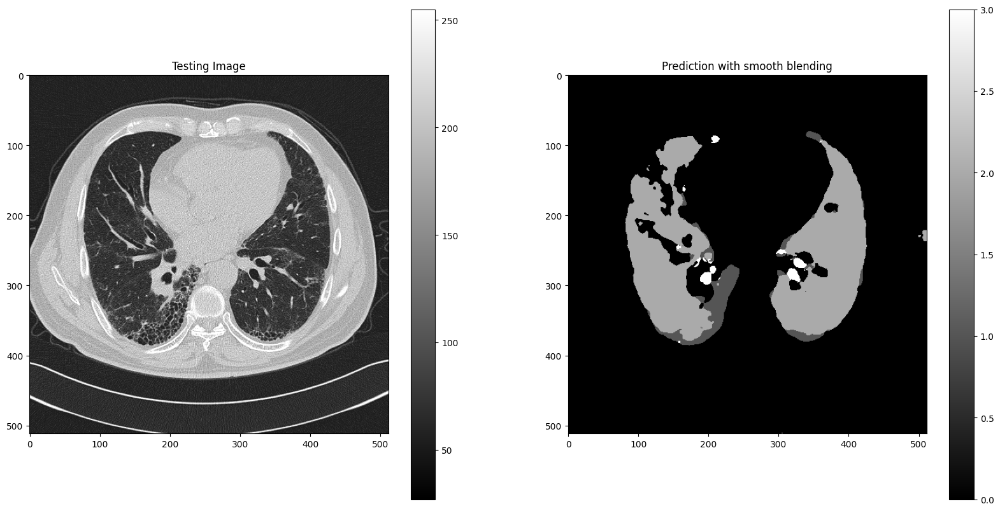

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 7s 2s/step


 12%|██████████▌                                                                         | 1/8 [00:08<00:56,  8.01s/it]

3/3 [==============================] - 7s 2s/step


 25%|█████████████████████                                                               | 2/8 [00:16<00:49,  8.22s/it]

3/3 [==============================] - 6s 2s/step


 38%|███████████████████████████████▌                                                    | 3/8 [00:23<00:39,  7.86s/it]

3/3 [==============================] - 7s 2s/step


 50%|██████████████████████████████████████████                                          | 4/8 [00:31<00:31,  7.76s/it]

3/3 [==============================] - 7s 2s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [00:38<00:22,  7.66s/it]

3/3 [==============================] - 7s 2s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [00:46<00:15,  7.61s/it]

3/3 [==============================] - 6s 2s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [00:53<00:07,  7.35s/it]

3/3 [==============================] - 6s 2s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [01:00<00:00,  7.51s/it]


segmentation_results_not_tested/vgg19/1164_segmented_vgg19.tif


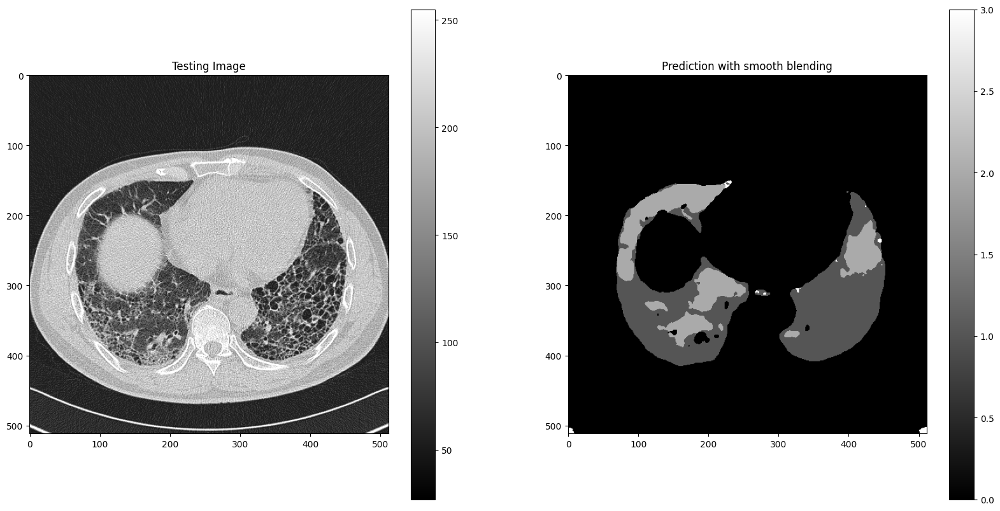

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

6/6 [==============================] - 13s 2s/step


 12%|██████████▌                                                                         | 1/8 [00:14<01:41, 14.47s/it]

6/6 [==============================] - 13s 2s/step


 25%|█████████████████████                                                               | 2/8 [00:27<01:23, 13.91s/it]

6/6 [==============================] - 12s 2s/step


 38%|███████████████████████████████▌                                                    | 3/8 [00:41<01:08, 13.70s/it]

6/6 [==============================] - 13s 2s/step


 50%|██████████████████████████████████████████                                          | 4/8 [00:55<00:54, 13.67s/it]

6/6 [==============================] - 13s 2s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [01:08<00:40, 13.59s/it]

6/6 [==============================] - 12s 2s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [01:21<00:27, 13.52s/it]

6/6 [==============================] - 13s 2s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [01:36<00:13, 13.79s/it]

6/6 [==============================] - 14s 2s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [01:51<00:00, 13.98s/it]


segmentation_results_not_tested/vgg19/1164_1_segmented_vgg19.tif


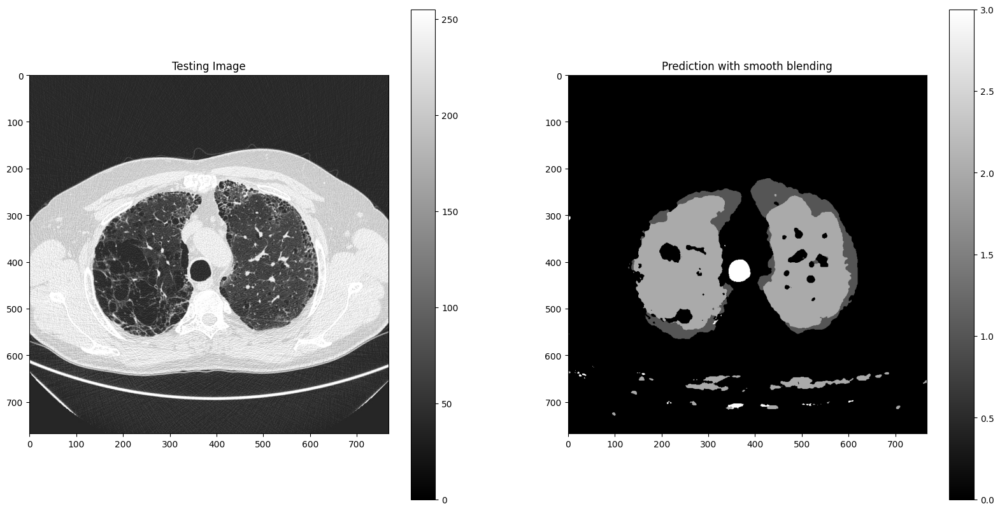

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 8s 2s/step


 12%|██████████▌                                                                         | 1/8 [00:09<01:03,  9.09s/it]

3/3 [==============================] - 8s 3s/step


 25%|█████████████████████                                                               | 2/8 [00:18<00:56,  9.39s/it]

3/3 [==============================] - 7s 2s/step


 38%|███████████████████████████████▌                                                    | 3/8 [00:26<00:43,  8.77s/it]

3/3 [==============================] - 7s 2s/step


 50%|██████████████████████████████████████████                                          | 4/8 [00:34<00:33,  8.44s/it]

3/3 [==============================] - 9s 2s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [00:44<00:26,  8.92s/it]

3/3 [==============================] - 9s 3s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [00:54<00:18,  9.33s/it]

3/3 [==============================] - 9s 3s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [01:05<00:09,  9.76s/it]

3/3 [==============================] - 7s 2s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [01:13<00:00,  9.21s/it]


segmentation_results_not_tested/vgg19/1164_2_segmented_vgg19.tif


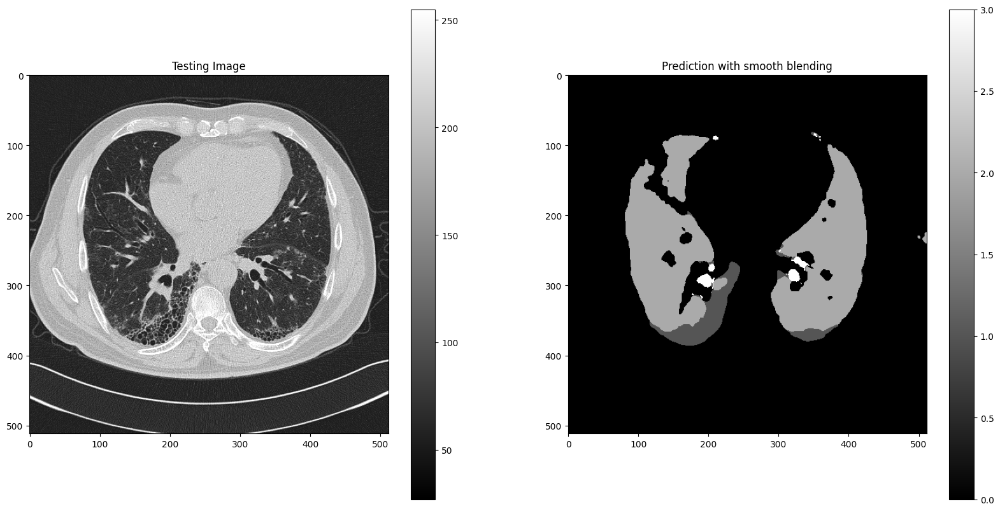

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 7s 2s/step


 12%|██████████▌                                                                         | 1/8 [00:08<00:58,  8.39s/it]

3/3 [==============================] - 11s 4s/step


 25%|█████████████████████                                                               | 2/8 [00:20<01:02, 10.38s/it]

3/3 [==============================] - 19s 5s/step


 38%|███████████████████████████████▌                                                    | 3/8 [00:40<01:15, 15.00s/it]

3/3 [==============================] - 19s 6s/step


 50%|██████████████████████████████████████████                                          | 4/8 [01:01<01:08, 17.17s/it]

3/3 [==============================] - 22s 7s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [01:24<00:58, 19.44s/it]

3/3 [==============================] - 34s 10s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [02:00<00:49, 24.88s/it]

3/3 [==============================] - 32s 11s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [02:34<00:28, 28.04s/it]

3/3 [==============================] - 31s 9s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [03:07<00:00, 23.44s/it]


segmentation_results_not_tested/vgg19/1165_segmented_vgg19.tif


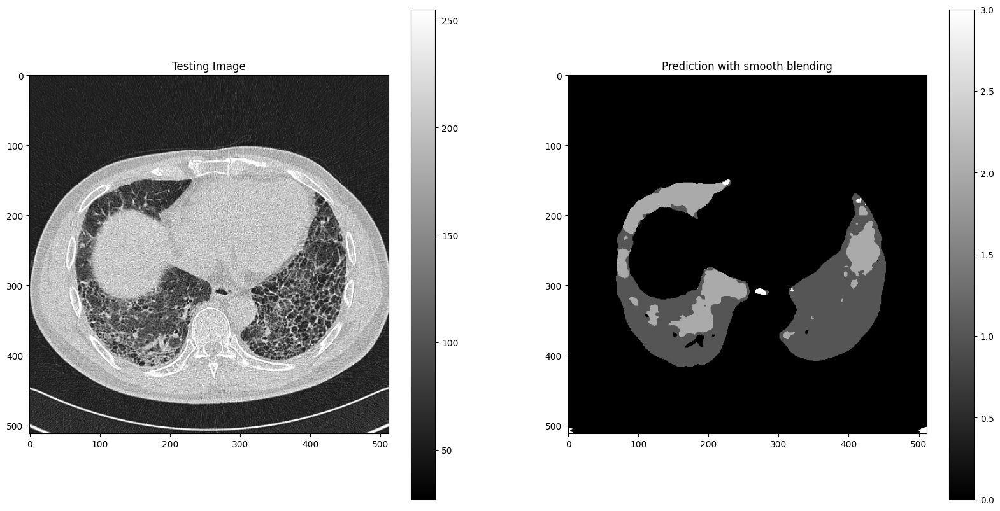

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 33s 11s/step


 12%|██████████▌                                                                         | 1/8 [00:43<05:07, 43.97s/it]

3/3 [==============================] - 35s 10s/step


 25%|█████████████████████                                                               | 2/8 [01:21<04:00, 40.10s/it]

3/3 [==============================] - 32s 9s/step


 38%|███████████████████████████████▌                                                    | 3/8 [01:55<03:06, 37.24s/it]

3/3 [==============================] - 35s 11s/step


 50%|██████████████████████████████████████████                                          | 4/8 [02:32<02:28, 37.12s/it]

3/3 [==============================] - 10s 2s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [02:44<01:24, 28.05s/it]

3/3 [==============================] - 7s 2s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [02:52<00:42, 21.39s/it]

3/3 [==============================] - 8s 2s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [03:01<00:17, 17.36s/it]

3/3 [==============================] - 7s 2s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [03:10<00:00, 23.76s/it]


segmentation_results_not_tested/vgg19/1165_1_segmented_vgg19.tif


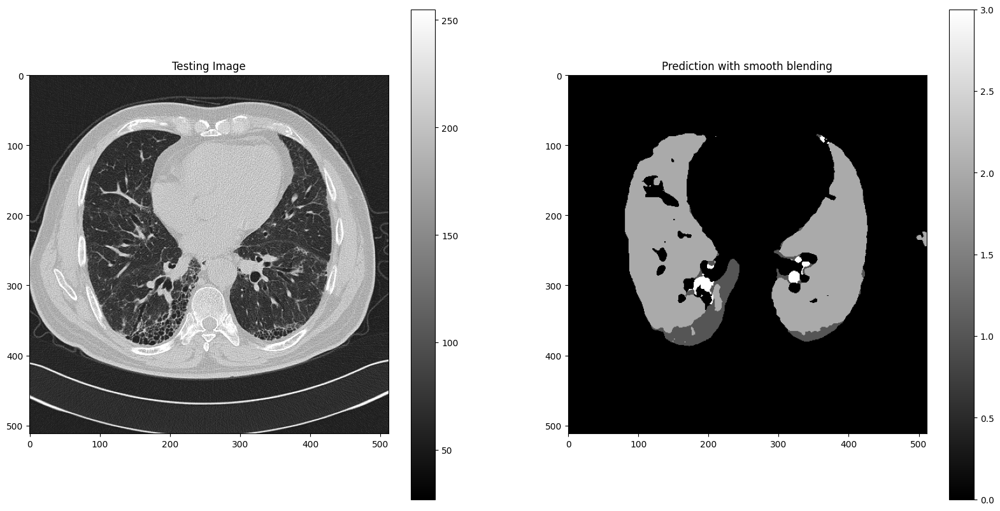

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 7s 2s/step


 12%|██████████▌                                                                         | 1/8 [00:07<00:54,  7.85s/it]

3/3 [==============================] - 6s 2s/step


 25%|█████████████████████                                                               | 2/8 [00:15<00:45,  7.54s/it]

3/3 [==============================] - 6s 2s/step


 38%|███████████████████████████████▌                                                    | 3/8 [00:21<00:36,  7.21s/it]

3/3 [==============================] - 6s 2s/step


 50%|██████████████████████████████████████████                                          | 4/8 [00:29<00:28,  7.14s/it]

3/3 [==============================] - 6s 2s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [00:36<00:21,  7.12s/it]

3/3 [==============================] - 7s 2s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [00:44<00:14,  7.40s/it]

3/3 [==============================] - 7s 2s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [00:51<00:07,  7.48s/it]

3/3 [==============================] - 7s 2s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:59<00:00,  7.42s/it]


segmentation_results_not_tested/vgg19/1166_segmented_vgg19.tif


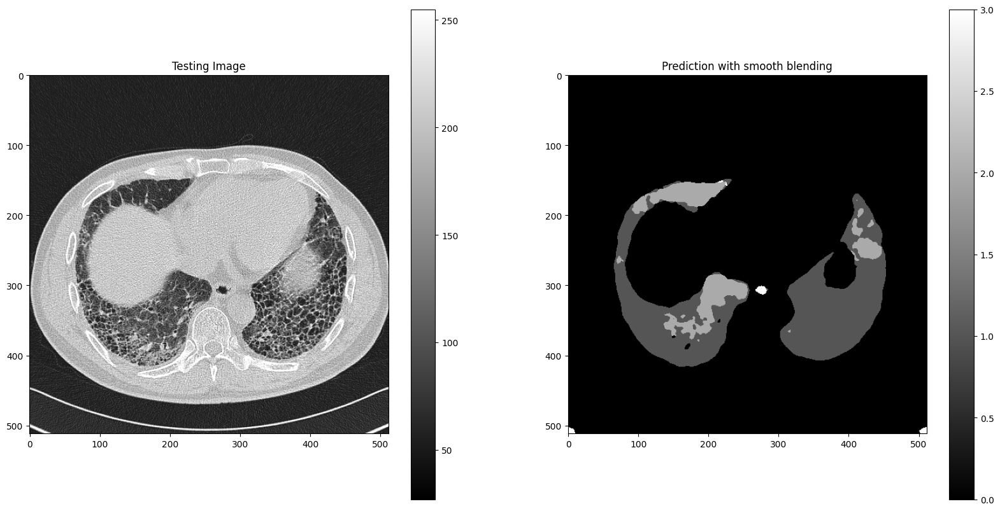

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 7s 2s/step


 12%|██████████▌                                                                         | 1/8 [00:08<00:57,  8.26s/it]

3/3 [==============================] - 7s 2s/step


 25%|█████████████████████                                                               | 2/8 [00:16<00:50,  8.40s/it]

3/3 [==============================] - 8s 2s/step


 38%|███████████████████████████████▌                                                    | 3/8 [00:25<00:43,  8.73s/it]

3/3 [==============================] - 7s 2s/step


 50%|██████████████████████████████████████████                                          | 4/8 [00:33<00:33,  8.37s/it]

3/3 [==============================] - 7s 2s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [00:41<00:24,  8.29s/it]

3/3 [==============================] - 8s 2s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [00:51<00:17,  8.61s/it]

3/3 [==============================] - 8s 3s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [01:00<00:08,  8.94s/it]

3/3 [==============================] - 8s 2s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [01:10<00:00,  8.75s/it]


segmentation_results_not_tested/vgg19/1167_segmented_vgg19.tif


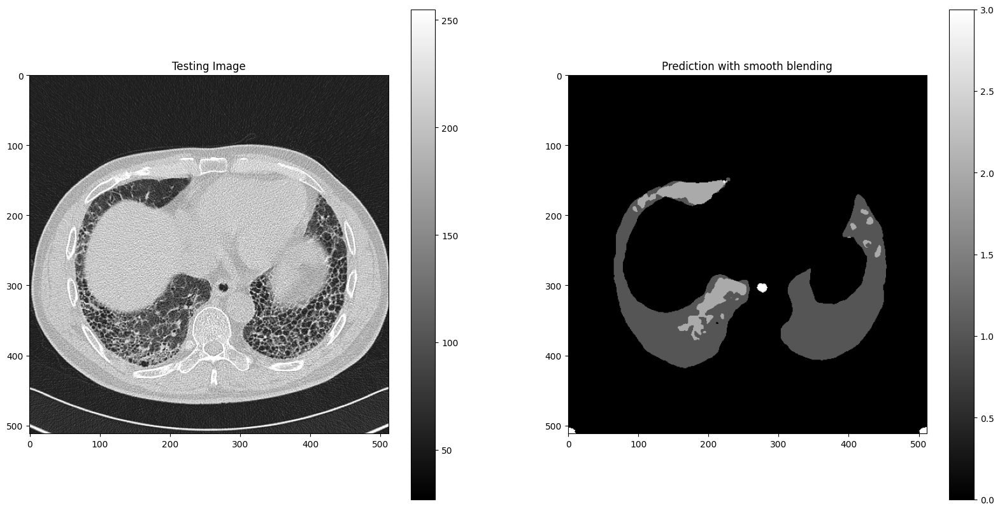

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 8s 2s/step


 12%|██████████▌                                                                         | 1/8 [00:08<01:01,  8.77s/it]

3/3 [==============================] - 7s 2s/step


 25%|█████████████████████                                                               | 2/8 [00:16<00:49,  8.25s/it]

3/3 [==============================] - 10s 4s/step


 38%|███████████████████████████████▌                                                    | 3/8 [00:27<00:48,  9.65s/it]

3/3 [==============================] - 23s 6s/step


 50%|██████████████████████████████████████████                                          | 4/8 [00:52<01:01, 15.48s/it]

3/3 [==============================] - 18s 5s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [01:10<00:49, 16.60s/it]

3/3 [==============================] - 18s 6s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [01:30<00:35, 17.63s/it]

3/3 [==============================] - 20s 6s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [01:52<00:18, 18.99s/it]

3/3 [==============================] - 31s 10s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [02:25<00:00, 18.20s/it]


segmentation_results_not_tested/vgg19/1167_1_segmented_vgg19.tif


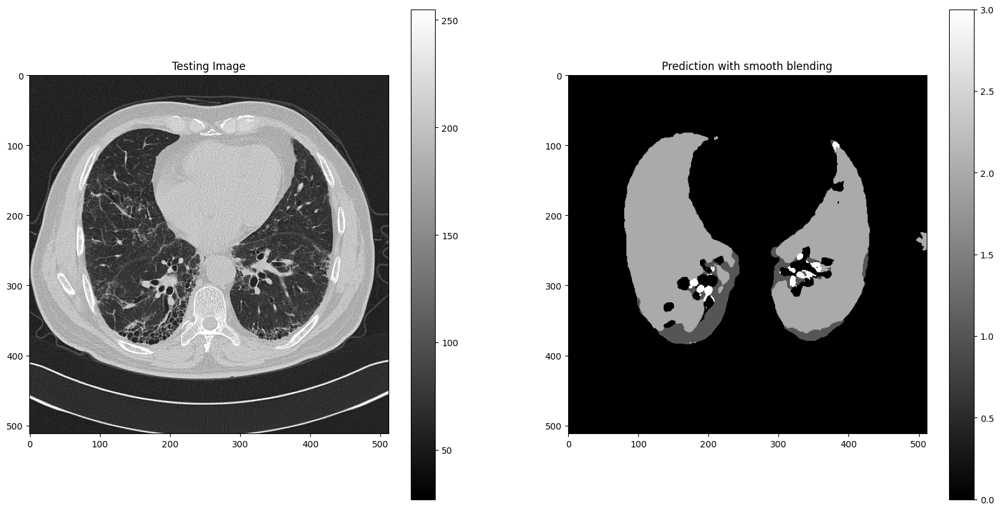

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 34s 12s/step


 12%|██████████▌                                                                         | 1/8 [00:43<05:07, 43.87s/it]

3/3 [==============================] - 37s 11s/step


 25%|█████████████████████                                                               | 2/8 [01:23<04:06, 41.15s/it]

3/3 [==============================] - 40s 13s/step


 38%|███████████████████████████████▌                                                    | 3/8 [02:06<03:29, 41.97s/it]

3/3 [==============================] - 38s 12s/step


 50%|██████████████████████████████████████████                                          | 4/8 [02:46<02:45, 41.33s/it]

3/3 [==============================] - 35s 12s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [03:29<02:05, 41.97s/it]

3/3 [==============================] - 34s 11s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [04:06<01:20, 40.23s/it]

3/3 [==============================] - 34s 10s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [04:50<00:41, 41.46s/it]

3/3 [==============================] - 36s 11s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [05:28<00:00, 41.12s/it]


segmentation_results_not_tested/vgg19/1168_segmented_vgg19.tif


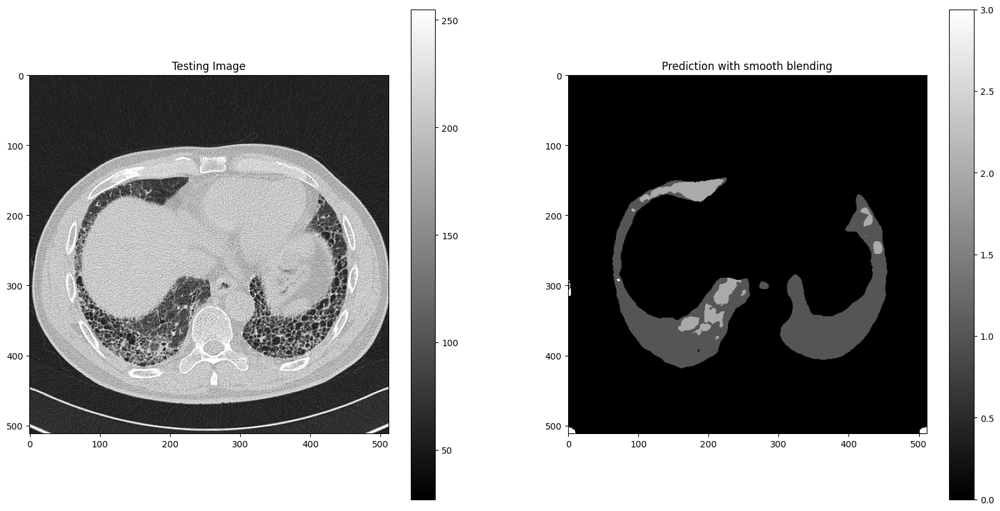

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 36s 11s/step


 12%|██████████▌                                                                         | 1/8 [00:38<04:31, 38.81s/it]

3/3 [==============================] - 35s 10s/step


 25%|█████████████████████                                                               | 2/8 [01:15<03:46, 37.81s/it]

3/3 [==============================] - 34s 10s/step


 38%|███████████████████████████████▌                                                    | 3/8 [01:52<03:06, 37.37s/it]

3/3 [==============================] - 33s 10s/step


 50%|██████████████████████████████████████████                                          | 4/8 [02:28<02:26, 36.65s/it]

3/3 [==============================] - 34s 10s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [03:04<01:49, 36.44s/it]

3/3 [==============================] - 32s 10s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [03:38<01:11, 35.80s/it]

3/3 [==============================] - 36s 11s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [04:17<00:36, 36.64s/it]

3/3 [==============================] - 34s 10s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [04:53<00:00, 36.72s/it]


segmentation_results_not_tested/vgg19/1169_segmented_vgg19.tif


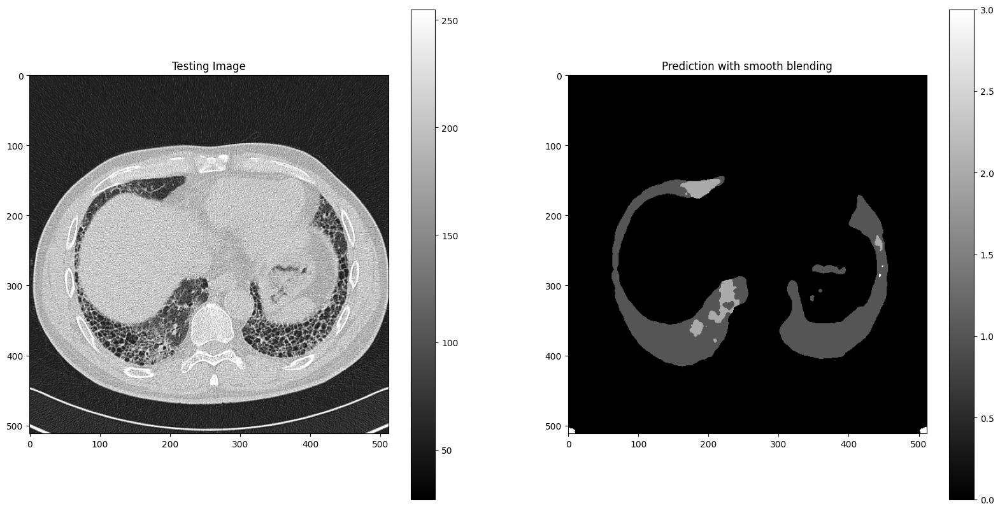

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 33s 10s/step


 12%|██████████▌                                                                         | 1/8 [00:35<04:07, 35.41s/it]

3/3 [==============================] - 34s 11s/step


 25%|█████████████████████                                                               | 2/8 [01:12<03:36, 36.13s/it]

3/3 [==============================] - 35s 10s/step


 38%|███████████████████████████████▌                                                    | 3/8 [01:49<03:02, 36.59s/it]

3/3 [==============================] - 33s 10s/step


 50%|██████████████████████████████████████████                                          | 4/8 [02:34<02:40, 40.08s/it]

3/3 [==============================] - 32s 10s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [03:09<01:54, 38.19s/it]

3/3 [==============================] - 37s 12s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [03:48<01:16, 38.47s/it]

3/3 [==============================] - 33s 10s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [04:23<00:37, 37.49s/it]

3/3 [==============================] - 34s 10s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [05:00<00:00, 37.53s/it]


segmentation_results_not_tested/vgg19/1169_1_segmented_vgg19.tif


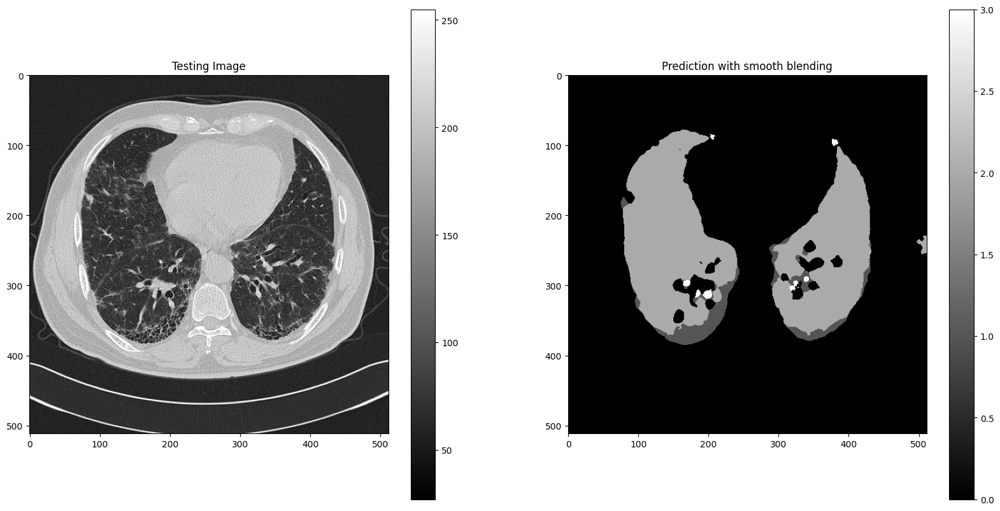

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 35s 11s/step


 12%|██████████▌                                                                         | 1/8 [00:37<04:23, 37.70s/it]

3/3 [==============================] - 36s 11s/step


 25%|█████████████████████                                                               | 2/8 [01:15<03:48, 38.00s/it]

3/3 [==============================] - 32s 10s/step


 38%|███████████████████████████████▌                                                    | 3/8 [01:50<03:02, 36.50s/it]

3/3 [==============================] - 33s 10s/step


 50%|██████████████████████████████████████████                                          | 4/8 [02:26<02:24, 36.19s/it]

3/3 [==============================] - 36s 11s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [03:04<01:50, 36.84s/it]

3/3 [==============================] - 34s 10s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [03:40<01:13, 36.60s/it]

3/3 [==============================] - 33s 10s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [04:15<00:36, 36.24s/it]

3/3 [==============================] - 33s 10s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [04:51<00:00, 36.41s/it]


segmentation_results_not_tested/vgg19/1170_segmented_vgg19.tif


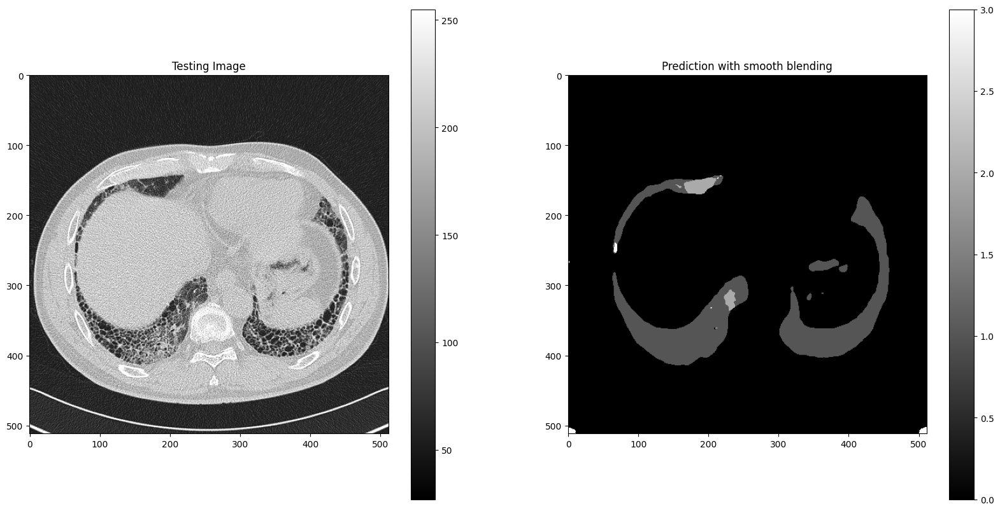

  0%|                                                                                            | 0/8 [00:00<?, ?it/s]

3/3 [==============================] - 36s 11s/step


 12%|██████████▌                                                                         | 1/8 [00:38<04:28, 38.39s/it]

3/3 [==============================] - 30s 10s/step


 25%|█████████████████████                                                               | 2/8 [01:10<03:27, 34.60s/it]

3/3 [==============================] - 36s 11s/step


 38%|███████████████████████████████▌                                                    | 3/8 [01:47<02:59, 35.89s/it]

3/3 [==============================] - 37s 11s/step


 50%|██████████████████████████████████████████                                          | 4/8 [02:26<02:28, 37.18s/it]

3/3 [==============================] - 33s 10s/step


 62%|████████████████████████████████████████████████████▌                               | 5/8 [03:02<01:50, 36.77s/it]

3/3 [==============================] - 37s 12s/step


 75%|███████████████████████████████████████████████████████████████                     | 6/8 [03:48<01:19, 39.58s/it]

3/3 [==============================] - 36s 12s/step


 88%|█████████████████████████████████████████████████████████████████████████▌          | 7/8 [04:26<00:39, 39.37s/it]

3/3 [==============================] - 33s 10s/step


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [05:02<00:00, 37.79s/it]


segmentation_results_not_tested/vgg19/1171_segmented_vgg19.tif


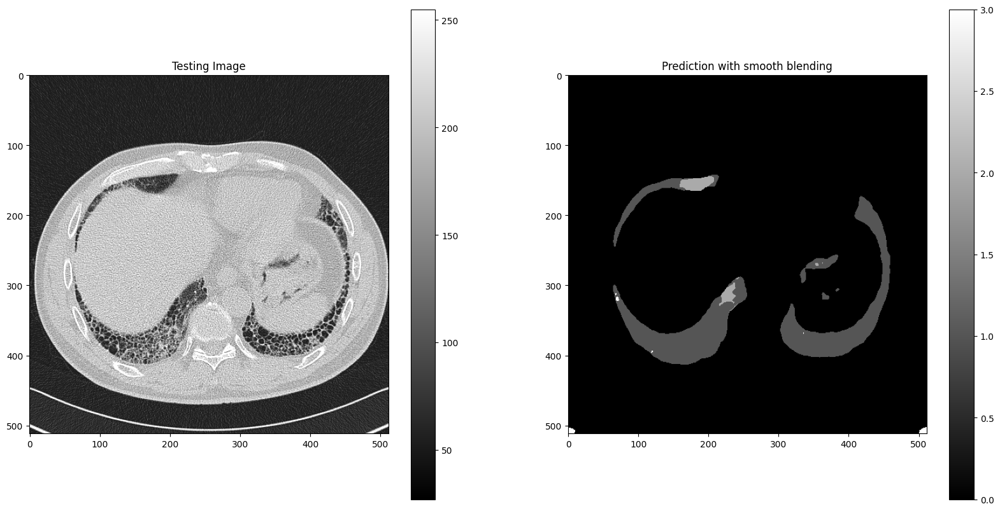

In [10]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from keras.models import load_model
import tifffile as tiff
# Set your backbone, preprocess_input, patch_size, and n_classes here
BACKBONE = 'vgg19'
preprocess_input = sm.get_preprocessing(BACKBONE)

# size of patches
patch_size = 128

# Number of classes 
n_classes = 4
# Specify the directory containing the images
image_directory = "../LargeImagesNotTested/"

# Define the result directory
result_directory = f'segmentation_results_not_tested/{BACKBONE}/'
os.makedirs(result_directory, exist_ok=True)

# List all image files in the directory
image_files = [file for file in os.listdir(image_directory) if file.endswith(".jpg")]

# Load the model
model = load_model(f'../Segmentation_Models/{BACKBONE}/CheckPoints/weights-improvement_{BACKBONE}.hdf5', compile=False)

# Loop through each image file in the directory
for image_file in image_files:
    # Load the image
    img = cv2.imread(os.path.join(image_directory, image_file))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    input_img = preprocess_input(img)

    # Predict using smooth blending
    predictions_smooth = predict_img_with_smooth_windowing(
        input_img,
        window_size=patch_size,
        subdivisions=2,
        nb_classes=n_classes,
        pred_func=(
            lambda img_batch_subdiv: model.predict((img_batch_subdiv))
        )
    )

    final_prediction = np.argmax(predictions_smooth, axis=2).astype(np.uint8)
    
    # Save the final prediction
    result_image_file = f'{result_directory}{os.path.splitext(image_file)[0]}_segmented_{BACKBONE}.tif'
    print(result_image_file)
    tiff.imwrite(result_image_file, final_prediction)
    
    # Display the original image and the prediction
    plt.figure(figsize=(20, 10))
    plt.subplot(121)
    plt.title('Testing Image')
    plt.imshow(img, cmap='gray')
    plt.colorbar()
    plt.subplot(122)
    plt.title('Prediction with smooth blending')
    plt.imshow(final_prediction, cmap='gray')
    plt.colorbar()
    plt.show()
